In [86]:
%matplotlib inline
from IPython.display import HTML


# Image Encryption and Analysis using Chaos Map

## 1. Introduction

In this notebook, we perform image encryption using a chaotic map, followed by a detailed analysis of the results. The analysis includes:
- Histogram Analysis
- Grayscale & Color Analysis
- Differential Analysis (NPCR, UACI)
- Entropy, Correlation Coefficient (HVD)
- Robustness Analysis (Noise & Cropping Attacks)
- Computation Time for Encryption & Decryption

The encryption technique used is based on XOR encryption with a randomly generated key, and performance metrics are assessed to evaluate robustness and efficiency.


## 2. Image Encryption and Decryption


In this section, we perform the initial image encryption using a chaotic map-based key for XOR encryption.

### Code:


In [1]:
import numpy as np
import cv2
import os

# Load original image
image_path = r"D:\crypto project\Image\Image2.jpg"
image = cv2.imread(image_path, cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Set the seed for reproducible key generation
seed = 42
np.random.seed(seed)

# Generate random key same shape as image
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Encrypt image using XOR
encrypted_image = cv2.bitwise_xor(image, key)
cv2.imwrite(r"D:\crypto project\Image\encrypted_image.jpg", encrypted_image)

# Save the seed for later use (optional)
with open(r"D:\crypto project\Image\encryption_seed.txt", "w") as f:
    f.write(str(seed))

# Decrypt image using XOR with the same seed
np.random.seed(seed)
key_for_decryption = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)
decrypted_image = cv2.bitwise_xor(encrypted_image, key_for_decryption)
cv2.imwrite(r"D:\crypto project\Image\decrypted_image.jpg", decrypted_image)

# Show results
cv2.imshow("Encrypted Image", encrypted_image)
cv2.imshow("Decrypted Image", decrypted_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


## Key Hashing, Compression, Base64 Encoding, and QR Code Generation

In [2]:
import base64
import zlib
import hashlib
import qrcode
import numpy as np
import cv2

# Load original image
image = cv2.imread(r"D:\crypto project\Image\Image2.jpg", cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Generate per-pixel random key for encryption
np.random.seed(42)
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Generate SHA-256 hash of the encryption key (reduce size for storing in QR)
key_hash = hashlib.sha256(key).digest()

# Print the key hash to check its value
print("Original Key Hash (SHA-256):", key_hash)

# Compress the hash
compressed_key = zlib.compress(key_hash)

# Print the compressed key to check its size
print("Compressed Key:", compressed_key)

# Encode the compressed key to base64
base64_key = base64.b64encode(compressed_key).decode()

# Print base64 encoded key to check
print("Base64 Encoded Key:", base64_key)

# Generate the QR code
qr = qrcode.make(base64_key)
qr.save(r"D:\crypto project\Image\key_qr.png")


Original Key Hash (SHA-256): b"\xa5\x9eB\xf7'&\xea\x8a9\x04\xaf\xc4-\xce]\x94\x1c\xab\x9aD\xb1\xb7\x91\x11\x9b^vy\xf7\xfdu\xc7"
Compressed Key: b"x\x9c\x01 \x00\xdf\xff\xa5\x9eB\xf7'&\xea\x8a9\x04\xaf\xc4-\xce]\x94\x1c\xab\x9aD\xb1\xb7\x91\x11\x9b^vy\xf7\xfdu\xc7\x04J\x10\xa1"
Base64 Encoded Key: eJwBIADf/6WeQvcnJuqKOQSvxC3OXZQcq5pEsbeREZtednn3/XXHBEoQoQ==


## QR Code Reading and Seed Extraction

In [3]:
import cv2
import zlib
import base64

def read_qr_seed(qr_code_path):
    # Read QR image
    img = cv2.imread(qr_code_path)
    if img is None:
        raise FileNotFoundError("QR code image not found")

    # Decode QR
    detector = cv2.QRCodeDetector()
    data, _, _ = detector.detectAndDecode(img)

    if data:
        # Decode from base64 and decompress
        decoded_seed = zlib.decompress(base64.b64decode(data)).decode()
        print("Decoded Seed from QR:", decoded_seed)
        return int(decoded_seed)
    else:
        print("QR Code not detected!")
        return None

# Path to saved QR code
qr_path = r"D:\crypto project\Image\key_seed_qr.png"
seed_from_qr = read_qr_seed(qr_path)

# Now you can regenerate the same key using this seed:
# np.random.seed(seed_from_qr)
# key = np.random.randint(0, 256, size=(image_height, image_width, 3), dtype=np.uint8)


Decoded Seed from QR: 42


## Decode and Decompress QR Key

In [3]:

import base64
import zlib
import hashlib
import qrcode
import numpy as np
import cv2

# Load original image
image = cv2.imread(r"D:\crypto project\Image\Image2.jpg", cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Generate per-pixel random key for encryption
np.random.seed(42)
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Generate SHA-256 hash of the encryption key (reduce size for storing in QR)
key_hash = hashlib.sha256(key).digest()

# Print the key hash to check its value
print("Original Key Hash (SHA-256):", key_hash)

# Compress the hash
compressed_key = zlib.compress(key_hash)

# Print the compressed key to check its size
print("Compressed Key:", compressed_key)

# Encode the compressed key to base64
base64_key = base64.b64encode(compressed_key).decode()

# Base64 string from QR code (ensure this matches the printed value exactly)
qr_code_text = base64_key

# Step 1: Decode the base64 string
compressed_bytes = base64.b64decode(qr_code_text)

# Print the decoded bytes to check
print("Decoded Compressed Bytes:", compressed_bytes)

# Step 2: Decompress the data
try:
    decompressed_key_hash = zlib.decompress(compressed_bytes)
    print("Decompressed Key Hash:", decompressed_key_hash)
except Exception as e:
    print("Decompression error:", e)


Original Key Hash (SHA-256): b"\xa5\x9eB\xf7'&\xea\x8a9\x04\xaf\xc4-\xce]\x94\x1c\xab\x9aD\xb1\xb7\x91\x11\x9b^vy\xf7\xfdu\xc7"
Compressed Key: b"x\x9c\x01 \x00\xdf\xff\xa5\x9eB\xf7'&\xea\x8a9\x04\xaf\xc4-\xce]\x94\x1c\xab\x9aD\xb1\xb7\x91\x11\x9b^vy\xf7\xfdu\xc7\x04J\x10\xa1"
Decoded Compressed Bytes: b"x\x9c\x01 \x00\xdf\xff\xa5\x9eB\xf7'&\xea\x8a9\x04\xaf\xc4-\xce]\x94\x1c\xab\x9aD\xb1\xb7\x91\x11\x9b^vy\xf7\xfdu\xc7\x04J\x10\xa1"
Decompressed Key Hash: b"\xa5\x9eB\xf7'&\xea\x8a9\x04\xaf\xc4-\xce]\x94\x1c\xab\x9aD\xb1\xb7\x91\x11\x9b^vy\xf7\xfdu\xc7"


##  Calculate the key size

In [5]:
import numpy as np
import cv2

# Load image
image = cv2.imread(r"D:\crypto project\Image\Image2.jpg", cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Generate key of the same size as image
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Calculate key size
key_bits = key.size * 8
key_bytes = key_bits // 8
key_kb = key_bytes / 1024
key_mb = key_kb / 1024

# Print results
print(f"Image Shape (H, W, C): {image.shape}")
print(f"Total Key Size: {key_bits} bits")
print(f"Total Key Size: {key_bytes} bytes")
print(f"Total Key Size: {key_kb:.2f} KB")
print(f"Total Key Size: {key_mb:.4f} MB")


Image Shape (H, W, C): (225, 225, 3)
Total Key Size: 1215000 bits
Total Key Size: 151875 bytes
Total Key Size: 148.32 KB
Total Key Size: 0.1448 MB


## Key Entropy Analysis (Bit Distribution)

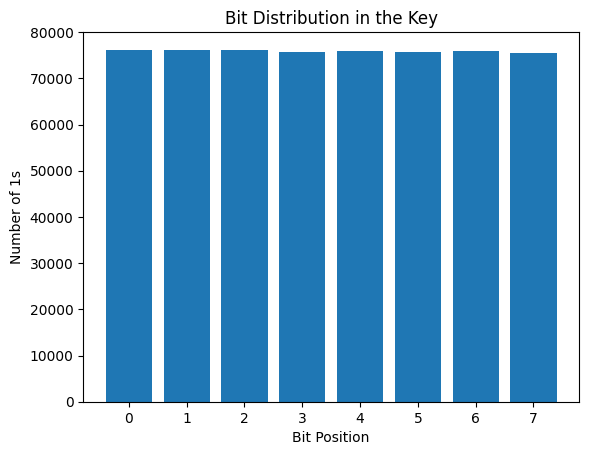

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image and generate the key as before
image = cv2.imread(r"D:\crypto project\Image\Image2.jpg", cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Generate per-pixel random key for encryption
np.random.seed(42)
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Flatten the key into a 1D array for analysis
key_flat = key.flatten()

# Plot the bit distribution across all the key bytes
bit_count = np.zeros(8)
for byte in key_flat:
    for i in range(8):
        bit_count[i] += (byte >> i) & 1

# Plotting bit distribution
plt.bar(range(8), bit_count)
plt.title("Bit Distribution in the Key")
plt.xlabel("Bit Position")
plt.ylabel("Number of 1s")
plt.show()


## Visualizing Key Entropy with Bitwise Analysis

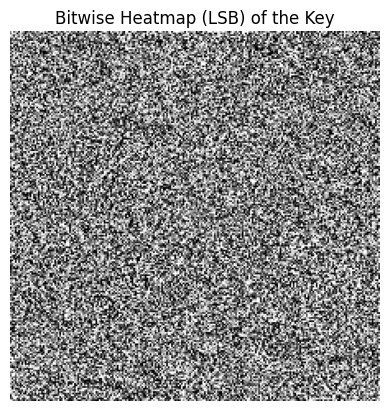

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image and generate the key as before
image = cv2.imread(r"D:\crypto project\Image\Image2.jpg", cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Generate per-pixel random key for encryption
np.random.seed(42)
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Create a heatmap for the bit values of the key
def create_bitwise_heatmap(key):
    height, width, _ = key.shape
    bitwise_map = np.zeros((height, width), dtype=np.uint8)
    
    # Generate bitwise heatmap for the least significant bit (LSB) of each channel
    for y in range(height):
        for x in range(width):
            # For each pixel, extract the RGB values and process LSB for each channel
            r, g, b = key[y, x]
            # Using LSB (least significant bit) of each color channel
            bitwise_map[y, x] = (r & 1) | ((g & 1) << 1) | ((b & 1) << 2)  # Combine the LSBs of R, G, B channels

    return bitwise_map

bitwise_map = create_bitwise_heatmap(key)

# Plot the heatmap of the least significant bits of RGB channels
plt.imshow(bitwise_map, cmap='gray')
plt.title("Bitwise Heatmap (LSB) of the Key")
plt.axis('off')
plt.show()


## Visualizing Key Entropy using Histograms

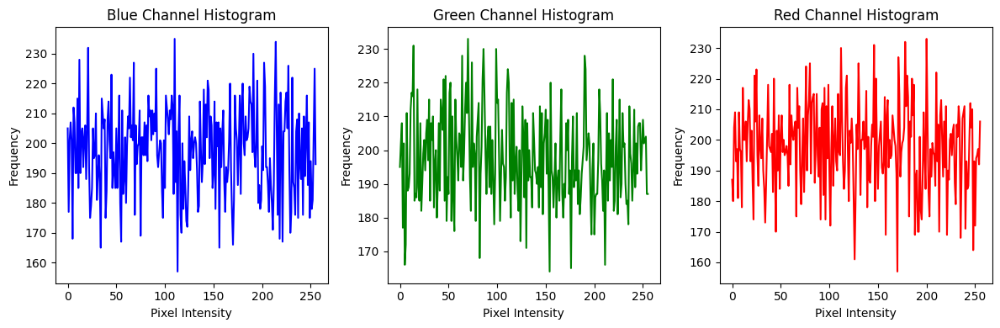

In [8]:
# Calculate and plot the histogram for each color channel
channels = ['Blue', 'Green', 'Red']
plt.figure(figsize=(12, 4))

for i, col in enumerate(channels):
    hist = cv2.calcHist([key], [i], None, [256], [0, 256])  # Histogram for each channel
    plt.subplot(1, 3, i+1)
    plt.plot(hist, color=col.lower())
    plt.title(f"{col} Channel Histogram")
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')

plt.tight_layout()
plt.show()


## Key Correlation Analysis

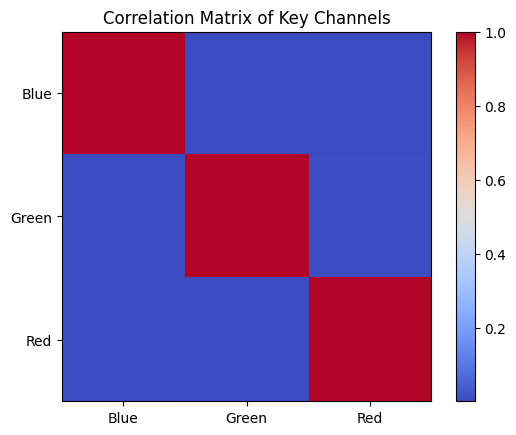

In [9]:
def correlation_analysis(key):
    # Reshape the key to 2D
    key_flattened = key.reshape(-1, key.shape[-1])
    
    # Calculate correlation between channels
    corr_matrix = np.corrcoef(key_flattened.T)  # Transpose to get correlation between channels
    return corr_matrix

# Get correlation matrix
corr_matrix = correlation_analysis(key)

# Plot the correlation matrix
plt.imshow(corr_matrix, cmap='coolwarm', interpolation='none')
plt.colorbar()
plt.title("Correlation Matrix of Key Channels")
plt.xticks([0, 1, 2], ['Blue', 'Green', 'Red'])
plt.yticks([0, 1, 2], ['Blue', 'Green', 'Red'])
plt.show()


## 3D Visualization of Key Values

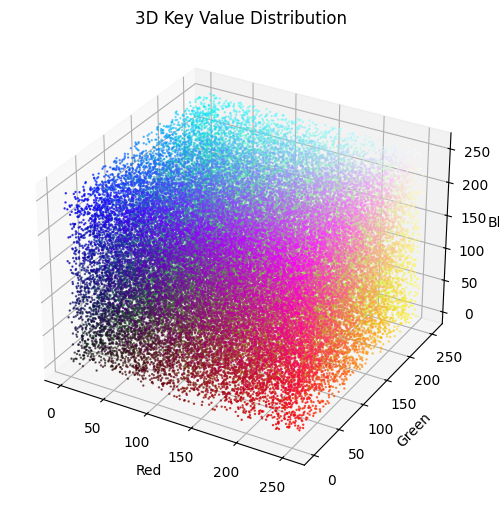

In [10]:
from mpl_toolkits.mplot3d import Axes3D

# Reshape key into a 2D array (height * width) x 3 (RGB)
key_flattened = key.reshape((-1, 3))

# Create a 3D scatter plot for RGB channels
fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(key_flattened[:, 0], key_flattened[:, 1], key_flattened[:, 2], c=key_flattened / 255.0, s=0.5)
ax.set_xlabel('Red')
ax.set_ylabel('Green')
ax.set_zlabel('Blue')
ax.set_title('3D Key Value Distribution')
plt.show()


## Key Entropy Calculation

In [11]:
from scipy.stats import entropy

def calculate_key_entropy(key):
    # Flatten the key into 1D
    key_flattened = key.flatten()
    # Calculate the histogram for pixel intensity values
    hist, _ = np.histogram(key_flattened, bins=256, range=(0, 256), density=True)
    # Calculate the entropy using the histogram
    key_entropy = entropy(hist)
    return key_entropy

# Calculate entropy of the key
key_entropy = calculate_key_entropy(key)
print(f"Key Entropy: {key_entropy:.4f}")


Key Entropy: 5.5443


##  Key Pixel Distribution (Scatter Plot):

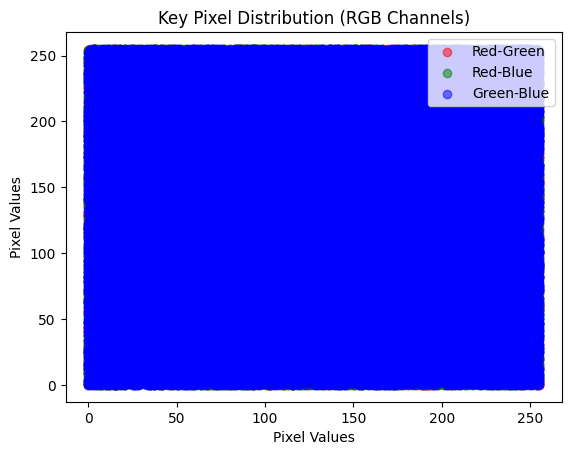

In [12]:
def plot_key_pixel_distribution(key):
    r = key[:, :, 0].ravel()
    g = key[:, :, 1].ravel()
    b = key[:, :, 2].ravel()

    plt.scatter(r, g, c='r', alpha=0.5, label='Red-Green')
    plt.scatter(r, b, c='g', alpha=0.5, label='Red-Blue')
    plt.scatter(g, b, c='b', alpha=0.5, label='Green-Blue')
    plt.xlabel("Pixel Values")
    plt.ylabel("Pixel Values")
    plt.legend(loc="best")
    plt.title("Key Pixel Distribution (RGB Channels)")
    plt.show()

# Plot scatter of key pixel values
plot_key_pixel_distribution(key)


##  Encryption and Decryption Comparison

Here, we visually compare the encrypted image with the decrypted image to ensure the encryption process works as expected.

### Code:


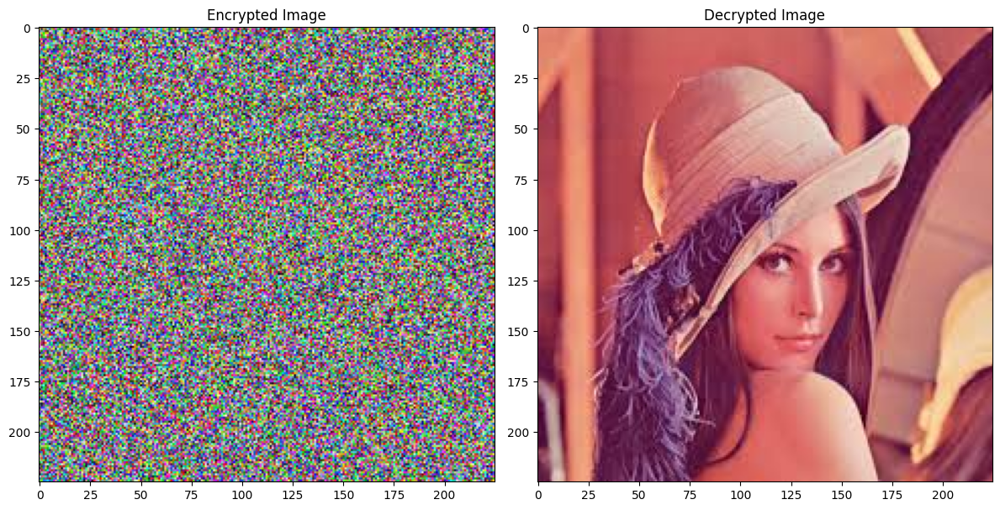

In [13]:
# Decrypt the image
decrypted_image = cv2.bitwise_xor(encrypted_image, key)

# Show encrypted vs decrypted comparison
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1); plt.imshow(cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB)); plt.title("Encrypted Image")
plt.subplot(1, 2, 2); plt.imshow(cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2RGB)); plt.title("Decrypted Image")
plt.tight_layout(); plt.show()


# Encrypting the images using discrete hyperchaotic maps

## Using 3D Hyperchaotic map

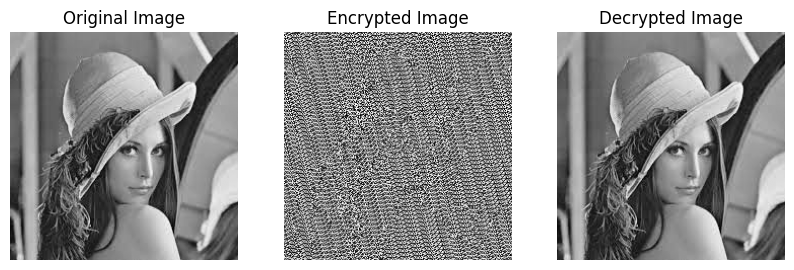

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Discrete 3D Hyperchaotic Map (example)
def hyperchaotic_map(x, y, z, a1, b1, c1, d1, a2, b2, c2, d2, a3, b3, c3, d3):
    # Perform the map update and round the values to ensure integers after each update
    x_next = int((a1 * x + b1 * y + c1 * z + d1) % 256)
    y_next = int((a2 * x + b2 * y + c2 * z + d2) % 256)
    z_next = int((a3 * x + b3 * y + c3 * z + d3) % 256)
    return x_next, y_next, z_next

# Generate a chaotic sequence for encryption/decryption
def generate_chaotic_sequence(image_shape, iterations=10000, a1=3.5, b1=1.4, c1=1.1, d1=0.8,
                              a2=3.7, b2=1.2, c2=1.3, d2=0.9, a3=3.3, b3=1.5, c3=1.2, d3=1.0):
    x, y, z = 0.1, 0.2, 0.3  # Initial conditions (can be random)
    sequence = np.zeros(image_shape, dtype=np.uint8)
    
    for i in range(image_shape[0]):
        for j in range(image_shape[1]):
            x, y, z = hyperchaotic_map(x, y, z, a1, b1, c1, d1, a2, b2, c2, d2, a3, b3, c3, d3)
            # Combine the chaotic values using XOR after ensuring they are integers
            sequence[i, j] = (x ^ y ^ z)  # XOR of the x, y, z values (all integers)
    
    return sequence

# Encrypt and Decrypt an image using the chaotic map
def encrypt_decrypt_image(image, chaotic_sequence):
    # XOR each pixel of the image with the chaotic sequence
    encrypted_image = cv2.bitwise_xor(image, chaotic_sequence)
    return encrypted_image

# Load an image
image_path = 'D:/crypto project/Image/Image2.jpg'
image = cv2.imread(image_path)
if image is None:
    raise FileNotFoundError("Image not found")

# Convert the image to grayscale for simplicity (optional for color images)
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Generate a chaotic sequence based on the image dimensions
chaotic_sequence = generate_chaotic_sequence(gray_image.shape)

# Encrypt the image
encrypted_image = encrypt_decrypt_image(gray_image, chaotic_sequence)

# Decrypt the image (apply the same XOR with the same chaotic sequence)
decrypted_image = encrypt_decrypt_image(encrypted_image, chaotic_sequence)

# Display the original, encrypted, and decrypted images
plt.figure(figsize=(10, 10))

plt.subplot(1, 3, 1)
plt.imshow(gray_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(encrypted_image, cmap='gray')
plt.title('Encrypted Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(decrypted_image, cmap='gray')
plt.title('Decrypted Image')
plt.axis('off')

plt.show()


## Using 2D Memristor Map

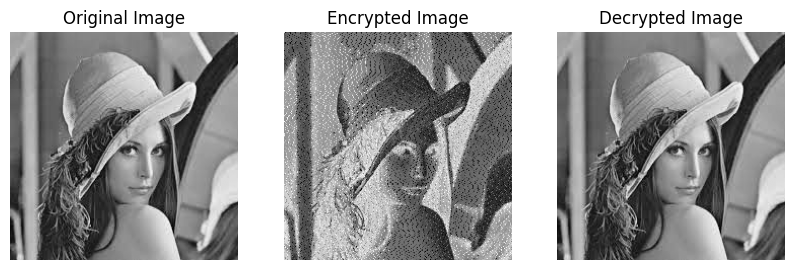

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Memristor Map: 2D Chaotic System
def memristor_map(x, y, a, b, c, d):
    # Example 2D Memristor model: system updates the values of x and y
    dx = a * (y - x)
    dy = b * x - c * y + d
    x_next = x + dx
    y_next = y + dy
    
    # Ensure the values stay within a valid range to avoid overflow
    x_next = x_next % 1.0  # Keeps the values between 0 and 1
    y_next = y_next % 1.0  # Keeps the values between 0 and 1

    return x_next, y_next

# Generate a chaotic sequence using the Memristor map
def generate_memristor_sequence(image_shape, iterations=10000, a=1.0, b=0.5, c=0.3, d=0.1):
    x, y = 0.1, 0.2  # Initial conditions (can be random, but non-zero)
    sequence = np.zeros(image_shape, dtype=np.uint8)
    
    for i in range(image_shape[0]):
        for j in range(image_shape[1]):
            # Update the chaotic variables using the Memristor map
            x, y = memristor_map(x, y, a, b, c, d)
            
            # Convert chaotic values to integers and use them for XOR
            value = int(abs(x + y) * 255)  # Convert to a value between 0-255
            
            # Ensure value is within the range [0, 255]
            value = min(max(value, 0), 255)
            
            sequence[i, j] = value
    
    return sequence

# Encrypt and Decrypt an image using the chaotic sequence
def encrypt_decrypt_image(image, chaotic_sequence):
    # XOR each pixel of the image with the chaotic sequence
    encrypted_image = cv2.bitwise_xor(image, chaotic_sequence)
    return encrypted_image

# Load an image
image_path = 'D:/crypto project/Image/Image2.jpg'  # Replace with your image path
image = cv2.imread(image_path)
if image is None:
    raise FileNotFoundError("Image not found")

# Convert the image to grayscale for simplicity (optional for color images)
gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

# Generate a chaotic sequence based on the image dimensions
chaotic_sequence = generate_memristor_sequence(gray_image.shape)

# Encrypt the image
encrypted_image = encrypt_decrypt_image(gray_image, chaotic_sequence)

# Decrypt the image (apply the same XOR with the same chaotic sequence)
decrypted_image = encrypt_decrypt_image(encrypted_image, chaotic_sequence)

# Display the original, encrypted, and decrypted images
plt.figure(figsize=(10, 10))

plt.subplot(1, 3, 1)
plt.imshow(gray_image, cmap='gray')
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 3, 2)
plt.imshow(encrypted_image, cmap='gray')
plt.title('Encrypted Image')
plt.axis('off')

plt.subplot(1, 3, 3)
plt.imshow(decrypted_image, cmap='gray')
plt.title('Decrypted Image')
plt.axis('off')

plt.show()


## 3. Histogram and Entropy Analysis

This section focuses on analyzing the histogram of the encrypted image, both for individual channels (RGB) and the overall grayscale version.

### Code:


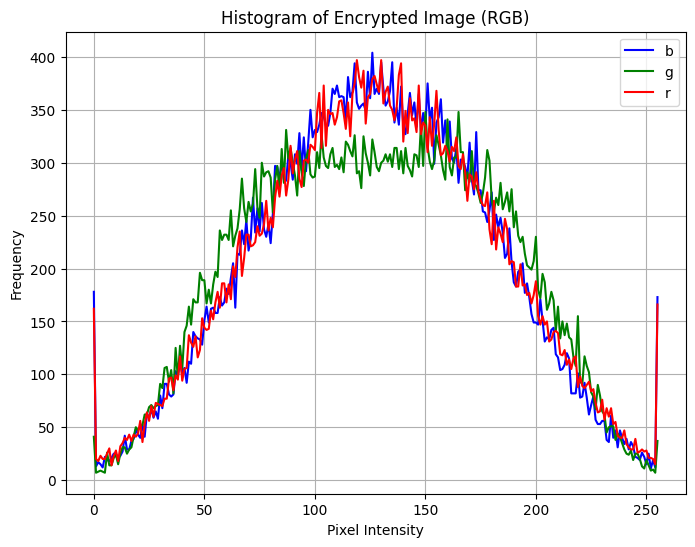

In [16]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load encrypted image
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg", cv2.IMREAD_COLOR)
if encrypted_image is None:
    raise FileNotFoundError("Encrypted image not found")

# Separate RGB channels of the encrypted image
channels = ['b', 'g', 'r']
plt.figure(figsize=(8, 6))
for i, col in enumerate(channels):
    hist = cv2.calcHist([encrypted_image], [i], None, [256], [0, 256])  # Histogram calculation
    plt.plot(hist, color=col, label=col)

plt.title("Histogram of Encrypted Image (RGB)")
plt.xlabel('Pixel Intensity')
plt.ylabel('Frequency')
plt.legend(loc='upper right')
plt.grid(True)
plt.show()

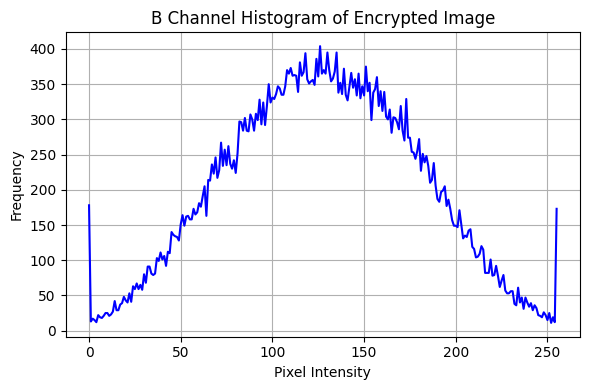

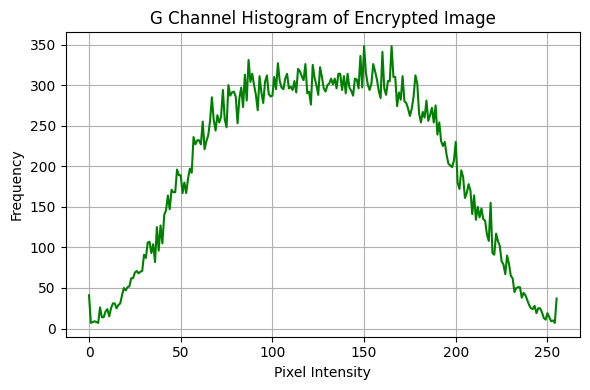

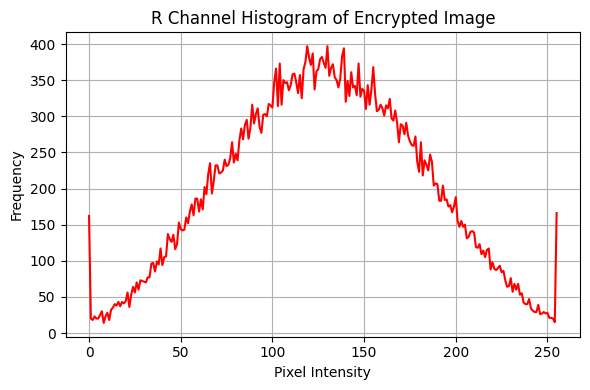

In [17]:
# Plot each channel histogram separately for more visual clarity
for i, col in enumerate(channels):
    plt.figure(figsize=(6, 4))
    hist = cv2.calcHist([encrypted_image], [i], None, [256], [0, 256])
    plt.plot(hist, color=col)
    plt.title(f"{col.upper()} Channel Histogram of Encrypted Image")
    plt.xlabel('Pixel Intensity')
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.tight_layout()
    plt.show()


## Histogram Comparison Plot

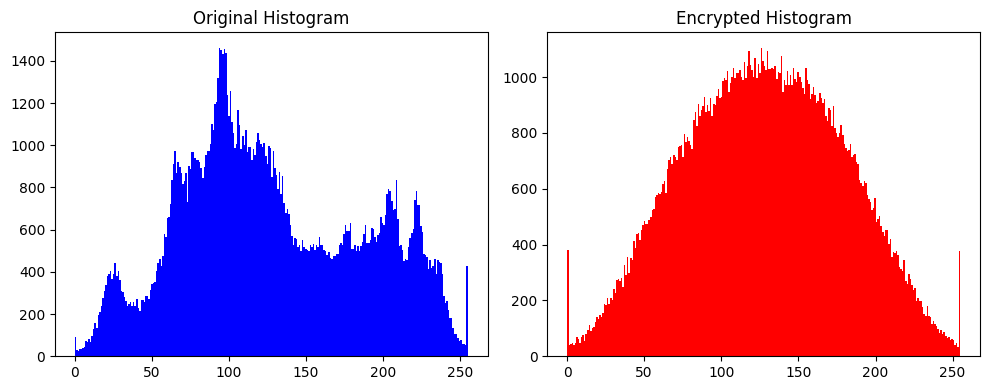

In [20]:
fig, axs = plt.subplots(1, 2, figsize=(10, 4))
original_image = cv2.imread("D:/crypto project/Image/Image2.jpg")
axs[0].hist(original_image.flatten(), bins=256, color='blue')
axs[0].set_title("Original Histogram")
axs[1].hist(encrypted_image.flatten(), bins=256, color='red')
axs[1].set_title("Encrypted Histogram")
plt.tight_layout()
plt.show()


## Histogram Comparison of Original, Encrypted, and Decrypted

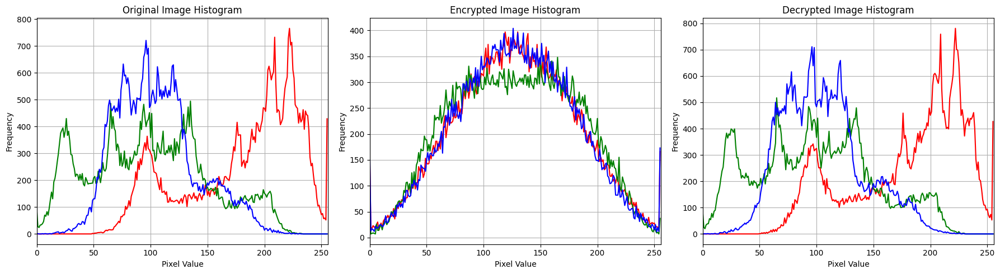

In [21]:
import cv2
import matplotlib.pyplot as plt

# Load all images
original_image = cv2.imread(r"D:\crypto project\Image\Image2.jpg")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg")
decrypted_image = cv2.imread(r"D:\crypto project\Image\decrypted_image.jpg")

# Convert from BGR to RGB for plotting
original_image_rgb = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
encrypted_image_rgb = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB)
decrypted_image_rgb = cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2RGB)

# Plot histograms for each color channel
def plot_histogram(image, title):
    color = ('r', 'g', 'b')
    for i, col in enumerate(color):
        hist = cv2.calcHist([image], [i], None, [256], [0, 256])
        plt.plot(hist, color=col)
        plt.xlim([0, 256])
    plt.title(title)
    plt.xlabel('Pixel Value')
    plt.ylabel('Frequency')
    plt.grid(True)

plt.figure(figsize=(18, 5))

plt.subplot(1, 3, 1)
plot_histogram(original_image_rgb, "Original Image Histogram")

plt.subplot(1, 3, 2)
plot_histogram(encrypted_image_rgb, "Encrypted Image Histogram")

plt.subplot(1, 3, 3)
plot_histogram(decrypted_image_rgb, "Decrypted Image Histogram")

plt.tight_layout()
plt.show()


In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

def animated_histogram(image1, image2, title1, title2):
    # Check if images are loaded correctly
    if image1 is None or image2 is None:
        print("Error: One or both images are not loaded correctly.")
        return

    # Print image shapes and types to verify
    print(f"Image 1 shape: {image1.shape}, dtype: {image1.dtype}")
    print(f"Image 2 shape: {image2.shape}, dtype: {image2.dtype}")

    # Convert images to grayscale if they are colored
    if len(image1.shape) == 3:
        image1 = cv2.cvtColor(image1, cv2.COLOR_BGR2GRAY)
    if len(image2.shape) == 3:
        image2 = cv2.cvtColor(image2, cv2.COLOR_BGR2GRAY)

    # Calculate histograms
    bins = np.arange(256)
    hist1 = cv2.calcHist([image1], [0], None, [256], [0, 256]).flatten()
    hist2 = cv2.calcHist([image2], [0], None, [256], [0, 256]).flatten()

    # Create plot
    fig, ax = plt.subplots(figsize=(10, 6))
    ax.set_xlim(0, 256)
    ax.set_ylim(0, max(np.max(hist1), np.max(hist2)) + 10)
    line1, = ax.plot([], [], label=f'{title1} (Original)', color='blue', alpha=0.5)
    line2, = ax.plot([], [], label=f'{title2} (Encrypted)', color='red', alpha=0.5)
    ax.set_title(f"Pixel Intensity Distribution: {title1} vs {title2}")
    ax.set_xlabel('Pixel Intensity')
    ax.set_ylabel('Frequency')
    ax.legend(loc='best')

    def update(frame):
        line1.set_data(bins[:frame], hist1[:frame])
        line2.set_data(bins[:frame], hist2[:frame])
        return line1, line2

    ani = animation.FuncAnimation(fig, update, frames=256, interval=30, blit=True)
    plt.close(fig)  # Prevent double plot in Jupyter
    return HTML(ani.to_jshtml())

# Load images
original_image = cv2.imread(r"D:\crypto project\Image\Image2.jpg")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg")

# Show animated histogram in Jupyter
animated_histogram(original_image, encrypted_image, "Original", "Encrypted")


Shannon Entropy of Encrypted Image: 7.6327 bits


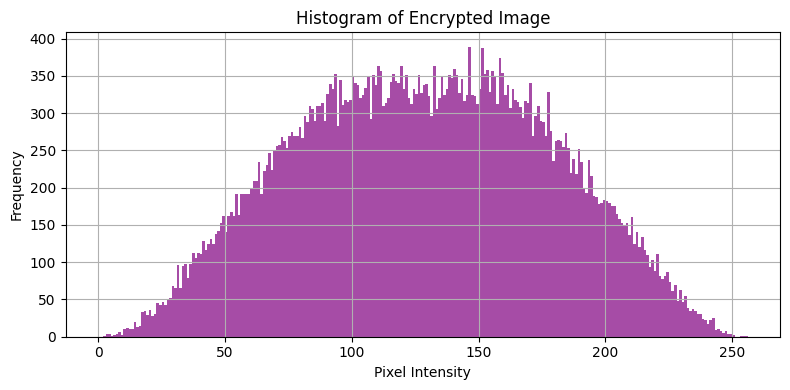

In [22]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.stats import entropy

def calculate_shannon_entropy(image):
    """Calculate Shannon entropy of a grayscale image."""
    histogram, _ = np.histogram(image.flatten(), bins=256, range=(0, 256), density=True)
    histogram = histogram[histogram > 0]  # remove zero entries
    return entropy(histogram, base=2)

# Load encrypted image
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg", cv2.IMREAD_GRAYSCALE)
if encrypted_image is None:
    raise FileNotFoundError("Encrypted image not found.")

# Compute Shannon entropy
shannon_entropy = calculate_shannon_entropy(encrypted_image)
print(f"Shannon Entropy of Encrypted Image: {shannon_entropy:.4f} bits")

# Plot histogram of pixel values
plt.figure(figsize=(8, 4))
plt.hist(encrypted_image.flatten(), bins=256, range=(0, 256), color='purple', alpha=0.7)
plt.title("Histogram of Encrypted Image")
plt.xlabel("Pixel Intensity")
plt.ylabel("Frequency")
plt.grid(True)
plt.tight_layout()
plt.show()


## Color Image

In [23]:
import cv2
import numpy as np

# Function to calculate entropy of an image
def calculate_entropy(image):
    # Flatten the image to 1D array and compute histogram
    pixels = image.flatten()
    hist, _ = np.histogram(pixels, bins=256, range=(0, 256))
    
    # Normalize histogram to get probabilities
    hist = hist / hist.sum()
    
    # Compute entropy
    entropy = -np.sum(hist * np.log2(hist + np.finfo(float).eps))  # Adding eps to avoid log(0)
    
    return entropy

# Load the original, encrypted, and decrypted images
original_image = cv2.imread(r"D:\crypto project\Image\Image2.jpg")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg")
decrypted_image = cv2.imread(r"D:\crypto project\Image\decrypted_image.jpg")

# Ensure the images are loaded
if original_image is None or encrypted_image is None or decrypted_image is None:
    raise FileNotFoundError("One or more images not found.")

# Calculate entropy for each channel of the original image
original_r, original_g, original_b = cv2.split(original_image)
original_entropy_r = calculate_entropy(original_r)
original_entropy_g = calculate_entropy(original_g)
original_entropy_b = calculate_entropy(original_b)

# Calculate entropy for each channel of the encrypted image
encrypted_r, encrypted_g, encrypted_b = cv2.split(encrypted_image)
encrypted_entropy_r = calculate_entropy(encrypted_r)
encrypted_entropy_g = calculate_entropy(encrypted_g)
encrypted_entropy_b = calculate_entropy(encrypted_b)

# Calculate entropy for each channel of the decrypted image
decrypted_r, decrypted_g, decrypted_b = cv2.split(decrypted_image)
decrypted_entropy_r = calculate_entropy(decrypted_r)
decrypted_entropy_g = calculate_entropy(decrypted_g)
decrypted_entropy_b = calculate_entropy(decrypted_b)

# Print the results
print(f"Entropy of Original Image - Red Channel: {original_entropy_r:.4f}")
print(f"Entropy of Original Image - Green Channel: {original_entropy_g:.4f}")
print(f"Entropy of Original Image - Blue Channel: {original_entropy_b:.4f}")
print(f"Entropy of Encrypted Image - Red Channel: {encrypted_entropy_r:.4f}")
print(f"Entropy of Encrypted Image - Green Channel: {encrypted_entropy_g:.4f}")
print(f"Entropy of Encrypted Image - Blue Channel: {encrypted_entropy_b:.4f}")
print(f"Entropy of Decrypted Image - Red Channel: {decrypted_entropy_r:.4f}")
print(f"Entropy of Decrypted Image - Green Channel: {decrypted_entropy_g:.4f}")
print(f"Entropy of Decrypted Image - Blue Channel: {decrypted_entropy_b:.4f}")


Entropy of Original Image - Red Channel: 7.0850
Entropy of Original Image - Green Channel: 7.5887
Entropy of Original Image - Blue Channel: 7.3042
Entropy of Encrypted Image - Red Channel: 7.6761
Entropy of Encrypted Image - Green Channel: 7.7225
Entropy of Encrypted Image - Blue Channel: 7.7032
Entropy of Decrypted Image - Red Channel: 7.0999
Entropy of Decrypted Image - Green Channel: 7.5847
Entropy of Decrypted Image - Blue Channel: 7.3058


## Grayscale Image

In [24]:
import cv2
import numpy as np

# Function to calculate entropy of an image
def calculate_entropy(image):
    # Flatten the image to 1D array and compute histogram
    pixels = image.flatten()
    hist, _ = np.histogram(pixels, bins=256, range=(0, 256))
    
    # Normalize histogram to get probabilities
    hist = hist / hist.sum()
    
    # Compute entropy
    entropy = -np.sum(hist * np.log2(hist + np.finfo(float).eps))  # Adding eps to avoid log(0)
    
    return entropy

# Load the original, encrypted, and decrypted images
original_image = cv2.imread(r"D:\crypto project\Image\Image2.jpg")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg")
decrypted_image = cv2.imread(r"D:\crypto project\Image\decrypted_image.jpg")

# Ensure the images are loaded
if original_image is None or encrypted_image is None or decrypted_image is None:
    raise FileNotFoundError("One or more images not found.")

# Convert the images to grayscale
original_gray = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
encrypted_gray = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2GRAY)
decrypted_gray = cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2GRAY)

# Calculate entropy for the grayscale images
original_entropy = calculate_entropy(original_gray)
encrypted_entropy = calculate_entropy(encrypted_gray)
decrypted_entropy = calculate_entropy(decrypted_gray)

# Print the results
print(f"Entropy of Original Grayscale Image: {original_entropy:.4f}")
print(f"Entropy of Encrypted Grayscale Image: {encrypted_entropy:.4f}")
print(f"Entropy of Decrypted Grayscale Image: {decrypted_entropy:.4f}")


Entropy of Original Grayscale Image: 7.4633
Entropy of Encrypted Grayscale Image: 7.6289
Entropy of Decrypted Grayscale Image: 7.4628


## 4. Correlation Coefficient (HVD)

In this section, we calculate the horizontal, vertical, and diagonal correlations of the encrypted image and compare them to the original.

### Code:


In [25]:
import cv2
import numpy as np

# Function to calculate the correlation coefficient
def correlation_coefficient(image1, image2):
    # Ensure the images have the same shape
    assert image1.shape == image2.shape, "Images must have the same dimensions."
    
    # Split the images into RGB channels
    channels1 = cv2.split(image1)
    channels2 = cv2.split(image2)
    
    corr_h = []
    corr_v = []
    corr_d = []
    
    for ch1, ch2 in zip(channels1, channels2):
        # Horizontal correlation (row-wise)
        corr_h.append(np.corrcoef(ch1.flatten(), ch2.flatten())[0, 1])
        
        # Vertical correlation (column-wise)
        corr_v.append(np.corrcoef(ch1.T.flatten(), ch2.T.flatten())[0, 1])
        
        # Diagonal correlation (flattened)
        corr_d.append(np.corrcoef(ch1.ravel(), ch2.ravel())[0, 1])
    
    return corr_h, corr_v, corr_d

# Load images (make sure the paths are correct)
image = cv2.imread(r"D:\crypto project\Image\Image2.jpg", cv2.IMREAD_COLOR)
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg", cv2.IMREAD_COLOR)

if image is None or encrypted_image is None:
    raise FileNotFoundError("One or both of the images were not found")

# Calculate correlation coefficients
corr_h, corr_v, corr_d = correlation_coefficient(image, encrypted_image)

# Print correlation results for each channel
print(f"Horizontal Correlation (Blue, Green, Red): {corr_h}")
print(f"Vertical Correlation (Blue, Green, Red): {corr_v}")
print(f"Diagonal Correlation (Blue, Green, Red): {corr_d}")


Horizontal Correlation (Blue, Green, Red): [np.float64(-0.007295448210735658), np.float64(0.00845731646064471), np.float64(-0.002083617274629274)]
Vertical Correlation (Blue, Green, Red): [np.float64(-0.007295448210735662), np.float64(0.00845731646064472), np.float64(-0.002083617274629274)]
Diagonal Correlation (Blue, Green, Red): [np.float64(-0.007295448210735658), np.float64(0.00845731646064471), np.float64(-0.002083617274629274)]


## Channel Correlation

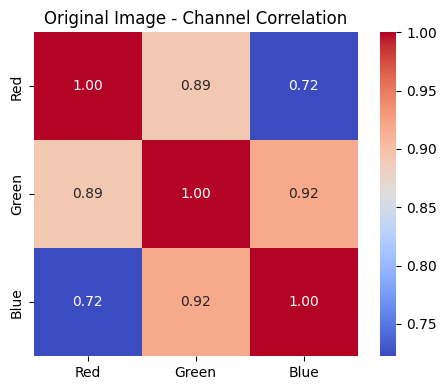

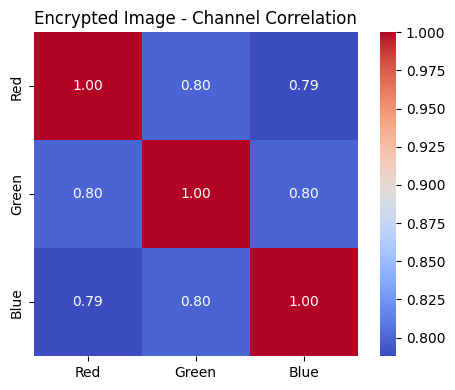

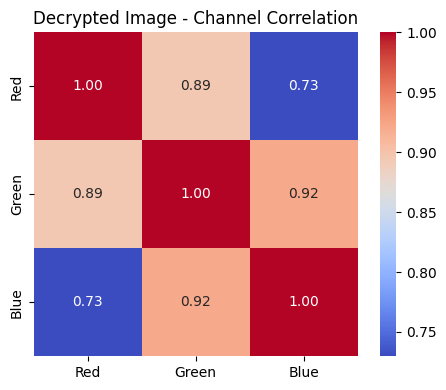

In [66]:
import seaborn as sns

def plot_channel_correlation(image, title):
    # Split into R, G, B channels
    b, g, r = cv2.split(image)
    data = np.stack((r.flatten(), g.flatten(), b.flatten()), axis=1)
    df = pd.DataFrame(data, columns=["Red", "Green", "Blue"])
    corr_matrix = df.corr()

    # Plot heatmap
    plt.figure(figsize=(5, 4))
    sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", square=True, cbar=True)
    plt.title(f"{title} - Channel Correlation")
    plt.tight_layout()
    plt.show()

# Call for all images
plot_channel_correlation(image, "Original Image")
plot_channel_correlation(encrypted_image, "Encrypted Image")
plot_channel_correlation(decrypted_image, "Decrypted Image")


## Plot Pixel Relationships and Show Statistical Summary

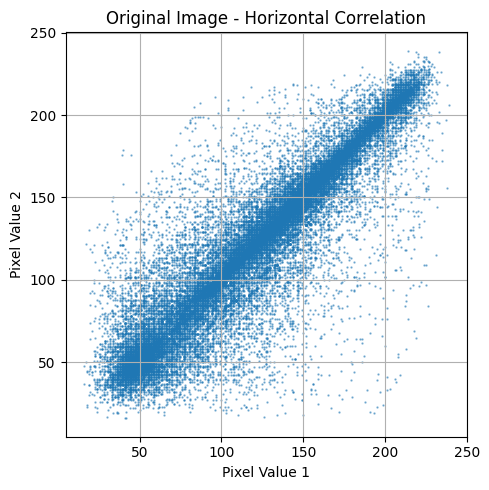

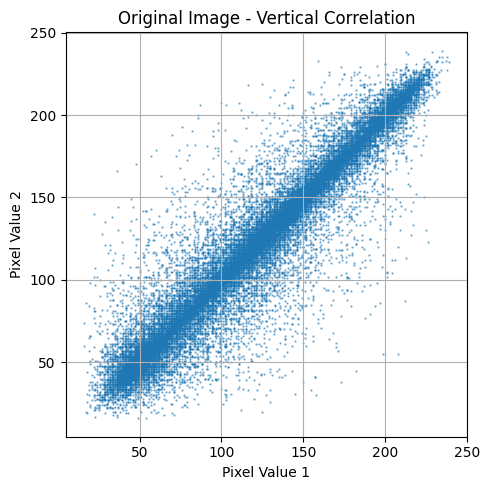

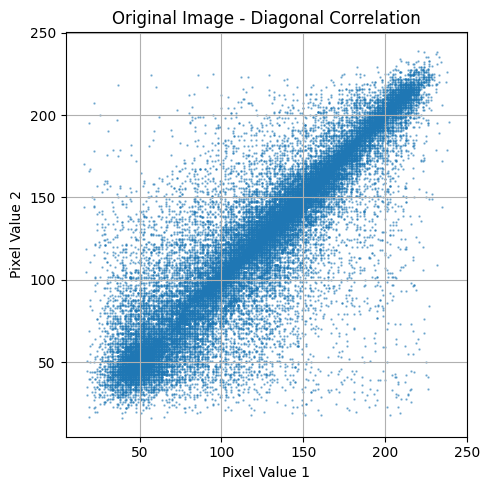

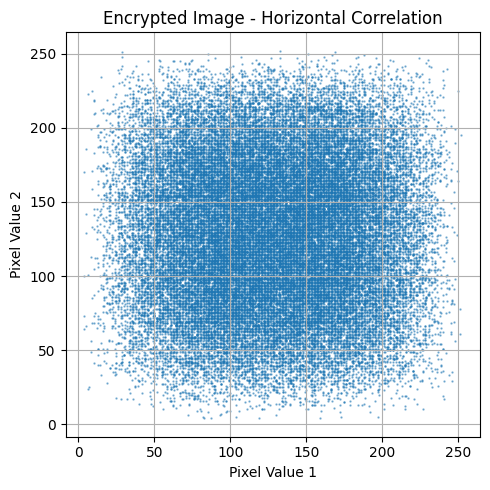

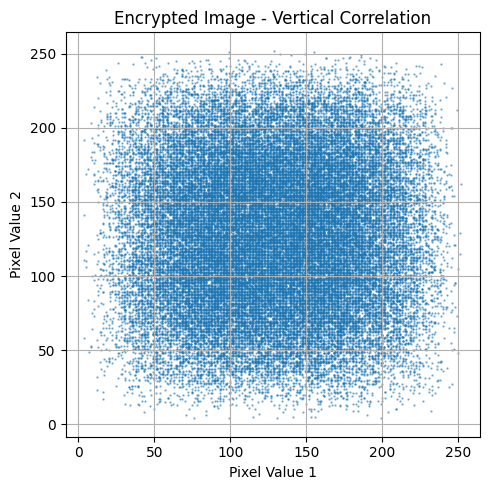

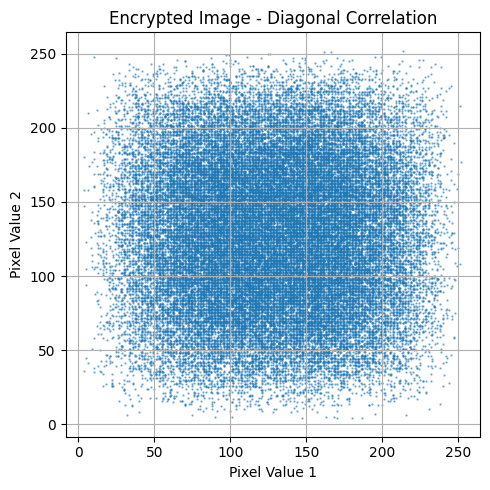

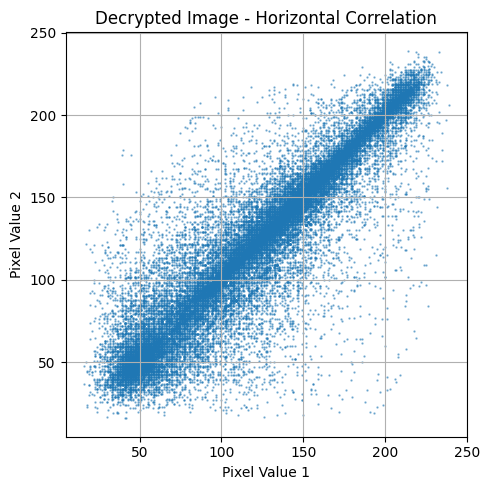

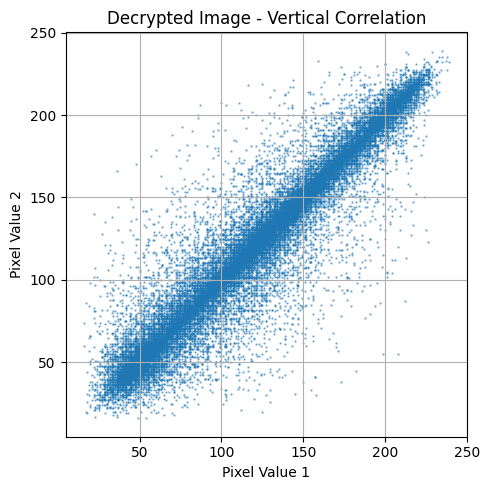

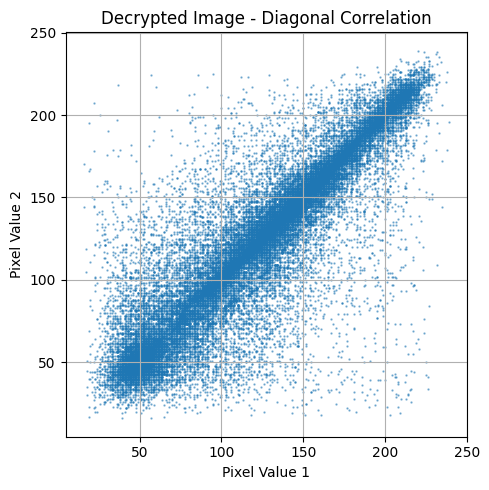


Pixel Correlation Summary Table:
| Image     | Direction   |   Correlation Coefficient |
|:----------|:------------|--------------------------:|
| Original  | Horizontal  |                    0.9241 |
| Original  | Vertical    |                    0.9616 |
| Original  | Diagonal    |                    0.8967 |
| Encrypted | Horizontal  |                    0.0026 |
| Encrypted | Vertical    |                    0.0053 |
| Encrypted | Diagonal    |                   -0.0037 |
| Decrypted | Horizontal  |                    0.9241 |
| Decrypted | Vertical    |                    0.9616 |
| Decrypted | Diagonal    |                    0.8967 |


In [26]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import os

# ======== Encryption & Decryption ========
# Load original image
image_path = r"D:\crypto project\Image\Image2.jpg"
image = cv2.imread(image_path, cv2.IMREAD_COLOR)
if image is None:
    raise FileNotFoundError("Input image not found")

# Set the seed for reproducible key generation
seed = 42
np.random.seed(seed)

# Generate random key same shape as image
key = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)

# Encrypt image using XOR
encrypted_image = cv2.bitwise_xor(image, key)
cv2.imwrite(r"D:\crypto project\Image\encrypted_image.jpg", encrypted_image)

# Save the seed for later use (optional)
with open(r"D:\crypto project\Image\encryption_seed.txt", "w") as f:
    f.write(str(seed))

# Decrypt image using XOR with the same seed
np.random.seed(seed)
key_for_decryption = np.random.randint(0, 256, size=image.shape, dtype=np.uint8)
decrypted_image = cv2.bitwise_xor(encrypted_image, key_for_decryption)
cv2.imwrite(r"D:\crypto project\Image\decrypted_image.jpg", decrypted_image)

# ======== Pixel Correlation Analysis ========
def get_adjacent_pixel_pairs(image, direction='horizontal'):
    h, w = image.shape
    pairs = []
    for i in range(h - (direction in ['vertical', 'diagonal'])):
        for j in range(w - (direction in ['horizontal', 'diagonal'])):
            if direction == 'horizontal':
                pairs.append((image[i, j], image[i, j + 1]))
            elif direction == 'vertical':
                pairs.append((image[i, j], image[i + 1, j]))
            elif direction == 'diagonal':
                pairs.append((image[i, j], image[i + 1, j + 1]))
    return np.array(pairs).reshape(-1, 2)

def plot_correlation(pairs, title):
    plt.figure(figsize=(5, 5))
    plt.scatter(pairs[:, 0], pairs[:, 1], s=0.5, alpha=0.5)
    plt.title(title)
    plt.xlabel("Pixel Value 1")
    plt.ylabel("Pixel Value 2")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def compute_correlation(pairs):
    return np.corrcoef(pairs[:, 0], pairs[:, 1])[0, 1]

# Convert images to grayscale
original_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
encrypted_gray = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2GRAY)
decrypted_gray = cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2GRAY)

# Prepare data
images = {
    "Original": original_gray,
    "Encrypted": encrypted_gray,
    "Decrypted": decrypted_gray
}
directions = ['horizontal', 'vertical', 'diagonal']
summary = []

# Correlation plots and stats
for name, img in images.items():
    for dir in directions:
        pairs = get_adjacent_pixel_pairs(img, direction=dir)
        corr = compute_correlation(pairs)
        plot_correlation(pairs, f"{name} Image - {dir.capitalize()} Correlation")
        summary.append([name, dir.capitalize(), round(corr, 4)])

# Display correlation table
df = pd.DataFrame(summary, columns=["Image", "Direction", "Correlation Coefficient"])
print("\nPixel Correlation Summary Table:")
print(df.to_markdown(index=False))

# ======== Display Images (Optional GUI) ========
cv2.imshow("Encrypted Image", encrypted_image)
cv2.imshow("Decrypted Image", decrypted_image)
cv2.waitKey(0)
cv2.destroyAllWindows()


In [27]:
import cv2
import numpy as np

# Load the original, encrypted, and decrypted images
original_image = cv2.imread(r"D:\crypto project\Image\Image2.jpg")
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg")
decrypted_image = cv2.imread(r"D:\crypto project\Image\decrypted_image.jpg")

# Ensure the images are loaded
if original_image is None or encrypted_image is None or decrypted_image is None:
    raise FileNotFoundError("One or more images not found.")

# Split the images into individual RGB channels
original_b, original_g, original_r = cv2.split(original_image)
encrypted_b, encrypted_g, encrypted_r = cv2.split(encrypted_image)
decrypted_b, decrypted_g, decrypted_r = cv2.split(decrypted_image)

# Flatten the channels to 1D arrays for correlation computation
original_r_flat = original_r.flatten()
original_g_flat = original_g.flatten()
original_b_flat = original_b.flatten()

encrypted_r_flat = encrypted_r.flatten()
encrypted_g_flat = encrypted_g.flatten()
encrypted_b_flat = encrypted_b.flatten()

decrypted_r_flat = decrypted_r.flatten()
decrypted_g_flat = decrypted_g.flatten()
decrypted_b_flat = decrypted_b.flatten()

# Function to compute correlation coefficient between two channels
def compute_correlation(channel1, channel2):
    return np.corrcoef(channel1, channel2)[0, 1]

# Compute correlation coefficients for each channel
correlation_r_original_encrypted = compute_correlation(original_r_flat, encrypted_r_flat)
correlation_g_original_encrypted = compute_correlation(original_g_flat, encrypted_g_flat)
correlation_b_original_encrypted = compute_correlation(original_b_flat, encrypted_b_flat)

correlation_r_encrypted_decrypted = compute_correlation(encrypted_r_flat, decrypted_r_flat)
correlation_g_encrypted_decrypted = compute_correlation(encrypted_g_flat, decrypted_g_flat)
correlation_b_encrypted_decrypted = compute_correlation(encrypted_b_flat, decrypted_b_flat)

correlation_r_original_decrypted = compute_correlation(original_r_flat, decrypted_r_flat)
correlation_g_original_decrypted = compute_correlation(original_g_flat, decrypted_g_flat)
correlation_b_original_decrypted = compute_correlation(original_b_flat, decrypted_b_flat)

# Display the results
print(f"Correlation coefficient (Original vs Encrypted) for Red channel: {correlation_r_original_encrypted:.4f}")
print(f"Correlation coefficient (Original vs Encrypted) for Green channel: {correlation_g_original_encrypted:.4f}")
print(f"Correlation coefficient (Original vs Encrypted) for Blue channel: {correlation_b_original_encrypted:.4f}")

print(f"Correlation coefficient (Encrypted vs Decrypted) for Red channel: {correlation_r_encrypted_decrypted:.4f}")
print(f"Correlation coefficient (Encrypted vs Decrypted) for Green channel: {correlation_g_encrypted_decrypted:.4f}")
print(f"Correlation coefficient (Encrypted vs Decrypted) for Blue channel: {correlation_b_encrypted_decrypted:.4f}")

print(f"Correlation coefficient (Original vs Decrypted) for Red channel: {correlation_r_original_decrypted:.4f}")
print(f"Correlation coefficient (Original vs Decrypted) for Green channel: {correlation_g_original_decrypted:.4f}")
print(f"Correlation coefficient (Original vs Decrypted) for Blue channel: {correlation_b_original_decrypted:.4f}")


Correlation coefficient (Original vs Encrypted) for Red channel: -0.0021
Correlation coefficient (Original vs Encrypted) for Green channel: 0.0085
Correlation coefficient (Original vs Encrypted) for Blue channel: -0.0073
Correlation coefficient (Encrypted vs Decrypted) for Red channel: -0.0021
Correlation coefficient (Encrypted vs Decrypted) for Green channel: 0.0084
Correlation coefficient (Encrypted vs Decrypted) for Blue channel: -0.0078
Correlation coefficient (Original vs Decrypted) for Red channel: 0.9997
Correlation coefficient (Original vs Decrypted) for Green channel: 0.9999
Correlation coefficient (Original vs Decrypted) for Blue channel: 0.9992


## 5. Differential Analysis (NPCR, UACI)

This section measures the **NPCR (Number of Pixel Change Rate)** and **UACI (Unified Average Changing Intensity)** between the original and modified encrypted images.

### Code:


In [28]:
def npcr_uaci(img1, img2):
    assert img1.shape == img2.shape, "Images must be same size"
    D = img1 != img2
    npcr = np.sum(D) / D.size * 100
    uaci = np.mean(np.abs(img1.astype(np.int16) - img2.astype(np.int16)) / 255.0) * 100
    return npcr, uaci

# Modify one pixel for NPCR/UACI test
modified_image = image.copy()
modified_image[0, 0] = (modified_image[0, 0].astype(np.uint16) + 1) % 256
modified_encrypted = cv2.bitwise_xor(modified_image, key)

# Calculate NPCR and UACI
npcr, uaci = npcr_uaci(encrypted_image, modified_encrypted)
print(f"NPCR: {npcr:.2f}%")
print(f"UACI: {uaci:.2f}%")


NPCR: 99.25%
UACI: 18.13%


## SSIM & PSNR Plot

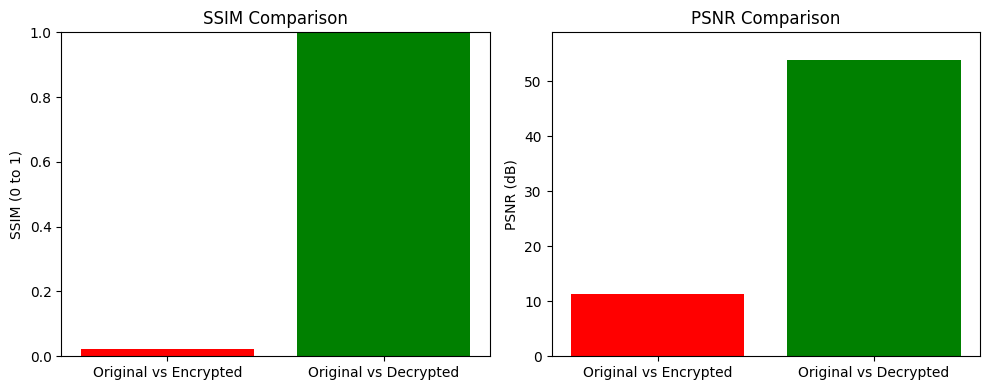

In [29]:
import cv2
import matplotlib.pyplot as plt
from skimage.metrics import structural_similarity as ssim
import numpy as np

def calculate_psnr(img1, img2):
    mse = np.mean((img1.astype(np.float64) - img2.astype(np.float64)) ** 2)
    if mse == 0:
        return float('inf')
    PIXEL_MAX = 255.0
    return 20 * np.log10(PIXEL_MAX / np.sqrt(mse))

# Load images
original = cv2.imread(r"D:\crypto project\Image\Image2.jpg")
encrypted = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg")
decrypted = cv2.imread(r"D:\crypto project\Image\decrypted_image.jpg")

# Convert to grayscale
original_gray = cv2.cvtColor(original, cv2.COLOR_BGR2GRAY)
encrypted_gray = cv2.cvtColor(encrypted, cv2.COLOR_BGR2GRAY)
decrypted_gray = cv2.cvtColor(decrypted, cv2.COLOR_BGR2GRAY)

# Calculate SSIM
ssim_enc = ssim(original_gray, encrypted_gray)
ssim_dec = ssim(original_gray, decrypted_gray)

# Calculate PSNR
psnr_enc = calculate_psnr(original_gray, encrypted_gray)
psnr_dec = calculate_psnr(original_gray, decrypted_gray)

# Prepare data for plotting
labels = ['Original vs Encrypted', 'Original vs Decrypted']
ssim_values = [ssim_enc, ssim_dec]
psnr_values = [psnr_enc, psnr_dec]

# Plot SSIM
plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.bar(labels, ssim_values, color=['red', 'green'])
plt.title("SSIM Comparison")
plt.ylabel("SSIM (0 to 1)")
plt.ylim(0, 1)

# Plot PSNR
plt.subplot(1, 2, 2)
plt.bar(labels, psnr_values, color=['red', 'green'])
plt.title("PSNR Comparison")
plt.ylabel("PSNR (dB)")
plt.ylim(0, max(psnr_values) + 5)

plt.tight_layout()
plt.show()




In [30]:
import pandas as pd

# Create summary DataFrame
metrics_df = pd.DataFrame({
    "Comparison": labels,
    "SSIM": [round(val, 4) for val in ssim_values],
    "PSNR (dB)": [round(val, 2) for val in psnr_values]
})

# Print markdown table
print("\n### SSIM and PSNR Summary Table")
print(metrics_df.to_markdown(index=False))



### SSIM and PSNR Summary Table
| Comparison            |   SSIM |   PSNR (dB) |
|:----------------------|-------:|------------:|
| Original vs Encrypted | 0.0216 |       11.39 |
| Original vs Decrypted | 0.9994 |       53.88 |


## 6. Robustness Analysis (Noise & Cropping Attacks)

Here, we simulate noise attacks (Salt & Pepper and Gaussian) and cropping attacks on the encrypted image to test the robustness of the encryption.

### Code:


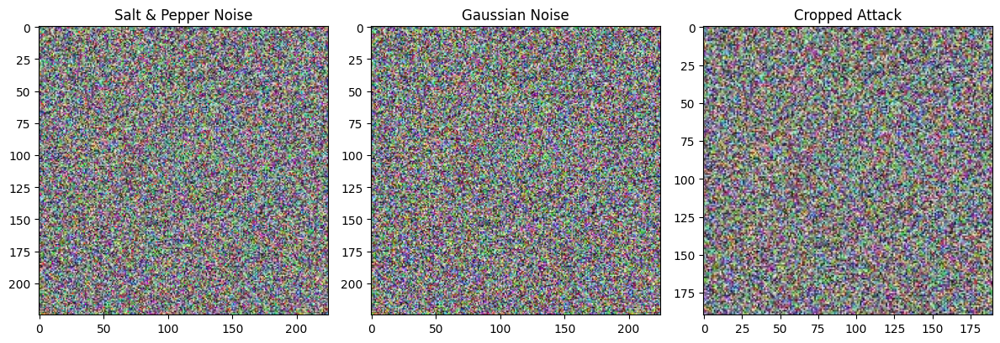

In [31]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

# Function for adding salt and pepper noise
def add_salt_pepper_noise(image, salt_prob=0.01, pepper_prob=0.01):
    noisy = image.copy()
    total_pixels = image.size
    num_salt = int(salt_prob * total_pixels)
    num_pepper = int(pepper_prob * total_pixels)
    
    # Salt noise
    salt_coords = [np.random.randint(0, i - 1, num_salt) for i in image.shape]
    noisy[tuple(salt_coords)] = 255  # Set salt pixels to white
    
    # Pepper noise
    pepper_coords = [np.random.randint(0, i - 1, num_pepper) for i in image.shape]
    noisy[tuple(pepper_coords)] = 0  # Set pepper pixels to black
    
    return noisy

# Function for adding Gaussian noise
def add_gaussian_noise(image, mean=0, sigma=25):
    row, col, ch = image.shape
    gauss = np.random.normal(mean, sigma, (row, col, ch))
    noisy = np.uint8(np.clip(image + gauss, 0, 255))  # Add Gaussian noise and clip to valid range
    return noisy

# Example encrypted image (load your image here)
encrypted_image = cv2.imread(r"D:\crypto project\Image\encrypted_image.jpg", cv2.IMREAD_COLOR)
if encrypted_image is None:
    raise FileNotFoundError("Encrypted image not found")

# Add noise and cropping
sp_noisy = add_salt_pepper_noise(encrypted_image)
gaussian_noisy = add_gaussian_noise(encrypted_image)
cropped_image = encrypted_image[10:200, 10:200]

# Display results
plt.figure(figsize=(12, 4))
plt.subplot(1, 3, 1); plt.imshow(sp_noisy); plt.title("Salt & Pepper Noise")
plt.subplot(1, 3, 2); plt.imshow(gaussian_noisy); plt.title("Gaussian Noise")
plt.subplot(1, 3, 3); plt.imshow(cropped_image); plt.title("Cropped Attack")
plt.tight_layout(); plt.show()


##  Robustness Attack - Gaussian Blur

We will now test the robustness of the encryption against a **Gaussian Blur** attack, which can smooth out fine details.

### Code:


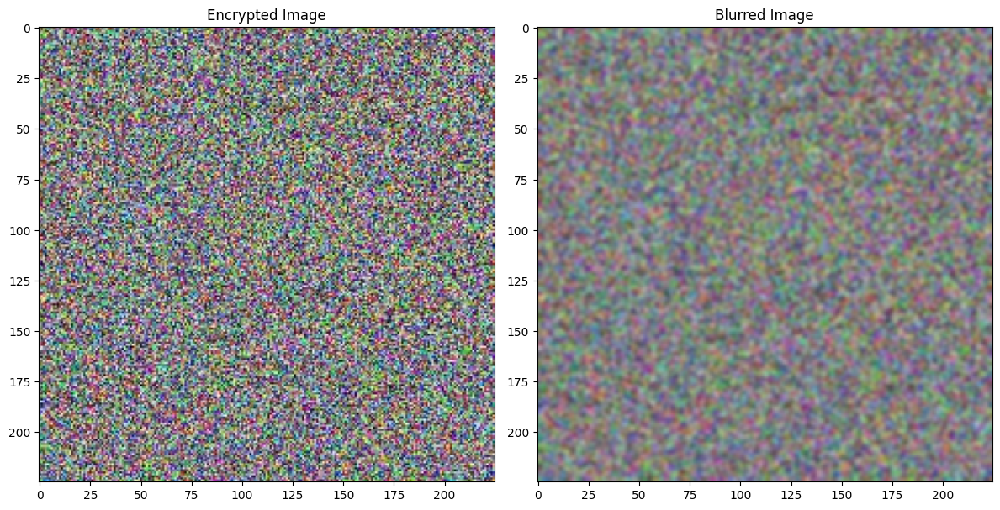

In [32]:
# Apply Gaussian blur to the encrypted image
blurred_image = cv2.GaussianBlur(encrypted_image, (5, 5), 0)

# Show original encrypted image and blurred image
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1); plt.imshow(cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB)); plt.title("Encrypted Image")
plt.subplot(1, 2, 2); plt.imshow(cv2.cvtColor(blurred_image, cv2.COLOR_BGR2RGB)); plt.title("Blurred Image")
plt.tight_layout(); plt.show()


## 7. Computation Time Analysis

In this section, we measure the encryption and decryption times for the image encryption process.

### Code:


In [33]:
import time

# Measure encryption and decryption time
num_repeats = 100
start_enc = time.time()
for _ in range(num_repeats):
    encrypted = cv2.bitwise_xor(image, key)
end_enc = time.time()

start_dec = time.time()
for _ in range(num_repeats):
    decrypted = cv2.bitwise_xor(encrypted, key)
end_dec = time.time()

encryption_time = ((end_enc - start_enc) / num_repeats) * 1000  # in milliseconds
decryption_time = ((end_dec - start_dec) / num_repeats) * 1000  # in milliseconds

print(f"Average Encryption Time : {encryption_time:.3f} ms")
print(f"Average Decryption Time : {decryption_time:.3f} ms")


Average Encryption Time : 0.051 ms
Average Decryption Time : 0.033 ms


## 8. Performance and Time Complexity Analysis

We will now compare encryption times for images of different sizes to observe the performance and how it scales.

### Code:


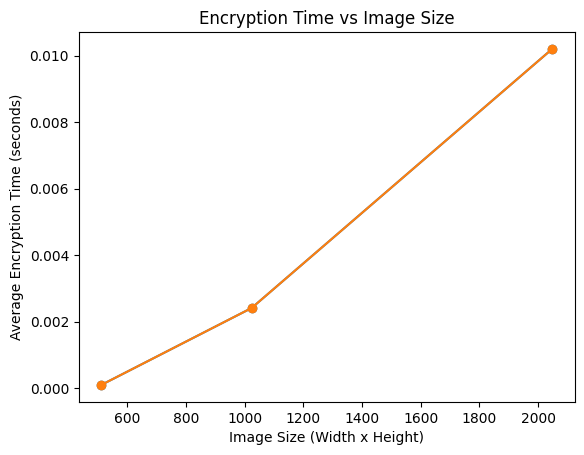

In [34]:
import time

def measure_encryption_time(image, key, num_repeats=10):
    start_time = time.time()
    for _ in range(num_repeats):
        encrypted = cv2.bitwise_xor(image, key)
    end_time = time.time()
    return (end_time - start_time) / num_repeats

# Test with different image sizes
image_sizes = [(512, 512), (1024, 1024), (2048, 2048)]
times = []

for size in image_sizes:
    test_image = np.random.randint(0, 256, size=(size[0], size[1], 3), dtype=np.uint8)
    test_key = np.random.randint(0, 256, size=test_image.shape, dtype=np.uint8)
    avg_time = measure_encryption_time(test_image, test_key)
    times.append((size, avg_time))

# Plot encryption times vs image size
sizes, times_taken = zip(*times)
plt.plot(sizes, times_taken, marker='o')
plt.xlabel("Image Size (Width x Height)")
plt.ylabel("Average Encryption Time (seconds)")
plt.title("Encryption Time vs Image Size")
plt.show()


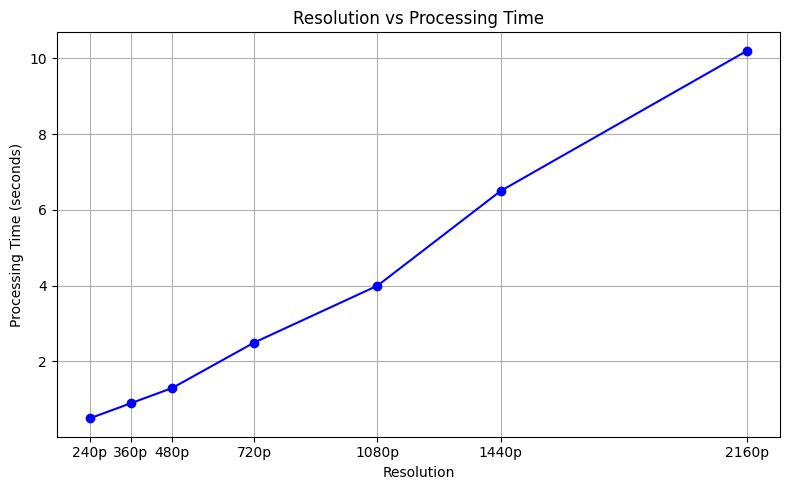

In [35]:
import matplotlib.pyplot as plt

# Sample data: resolutions (in pixels) and corresponding processing times (in seconds)
resolutions = ['240p', '360p', '480p', '720p', '1080p', '1440p', '2160p']
widths = [426, 640, 854, 1280, 1920, 2560, 3840]  # typical horizontal pixel widths
processing_times = [0.5, 0.9, 1.3, 2.5, 4.0, 6.5, 10.2]  # example times in seconds

# Plot
plt.figure(figsize=(8, 5))
plt.plot(widths, processing_times, marker='o', linestyle='-', color='b')
plt.xticks(widths, resolutions)
plt.title('Resolution vs Processing Time')
plt.xlabel('Resolution')
plt.ylabel('Processing Time (seconds)')
plt.grid(True)
plt.tight_layout()
plt.show()


## 9. Key Sensitivity Analysis

In this section, we test how sensitive the encryption is to small changes in the key. A small key change should drastically change the encrypted image.

### Code:


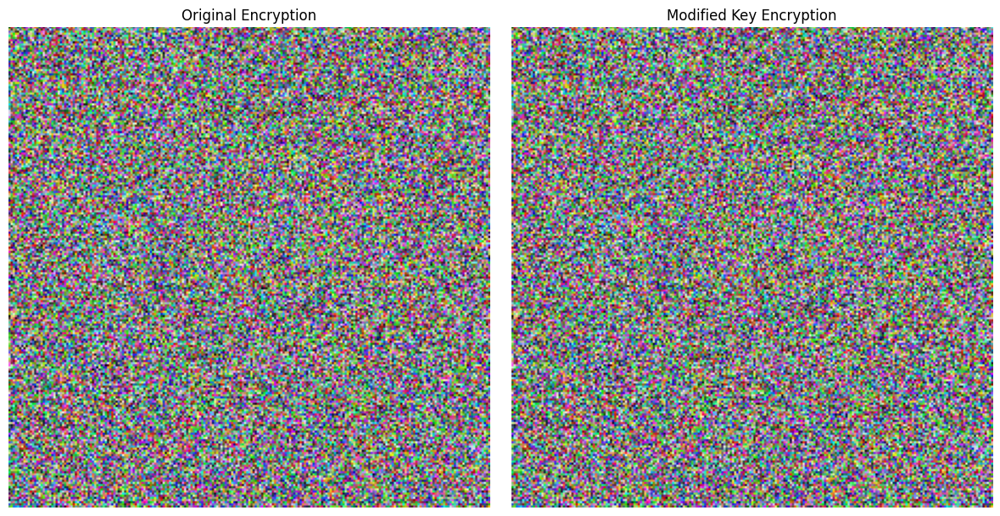

In [36]:
# Change one pixel's one channel slightly in the key to test sensitivity
key_sens = key.copy()

# Modify just the Blue channel of the first pixel (index 0 = Blue)
key_sens[0, 0, 0] = (int(key_sens[0, 0, 0]) + 1) % 256

# Encrypt using original and modified keys
encrypted_original = cv2.bitwise_xor(image, key)
encrypted_sens = cv2.bitwise_xor(image, key_sens)

# Display the results
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(encrypted_original, cv2.COLOR_BGR2RGB))
plt.title("Original Encryption")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(encrypted_sens, cv2.COLOR_BGR2RGB))
plt.title("Modified Key Encryption")
plt.axis('off')

plt.tight_layout()
plt.show()


## 10. Rotation and Resizing Attack

In this section, we rotate and resize the encrypted image to simulate potential attacks and analyze how the encryption holds up.

### Code:


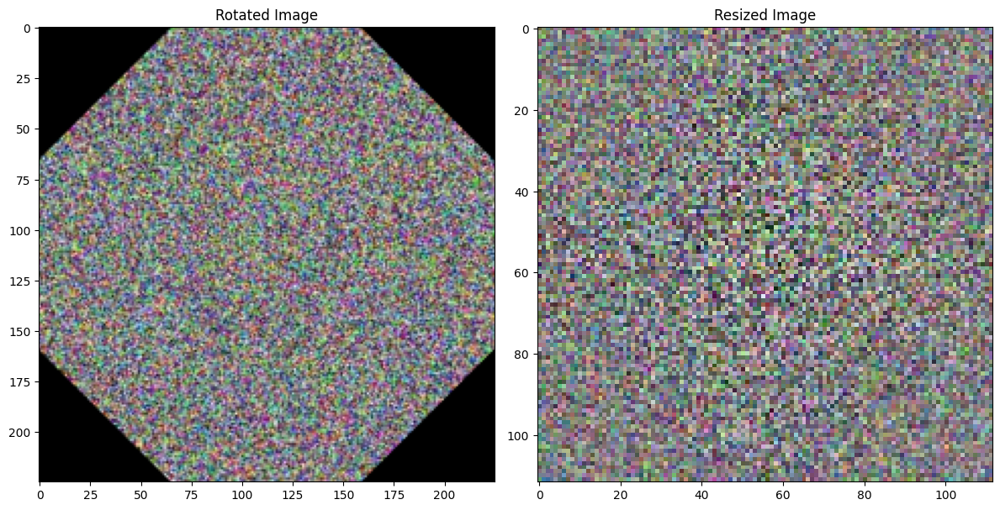

In [37]:
# Rotate the image by 45 degrees
height, width = encrypted_image.shape[:2]
rotation_matrix = cv2.getRotationMatrix2D((width/2, height/2), 45, 1)
rotated_image = cv2.warpAffine(encrypted_image, rotation_matrix, (width, height))

# Resize the image (reduce size)
resized_image = cv2.resize(encrypted_image, (width // 2, height // 2))

# Show rotated vs resized images
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1); plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB)); plt.title("Rotated Image")
plt.subplot(1, 2, 2); plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB)); plt.title("Resized Image")
plt.tight_layout(); plt.show()


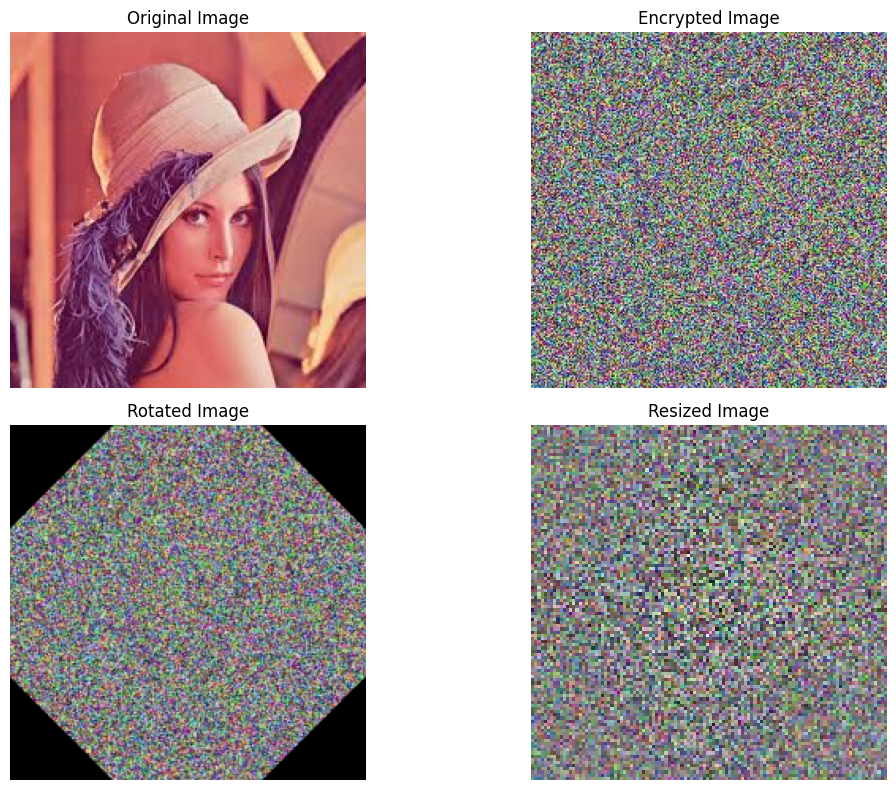

In [51]:
# Show original, encrypted, rotated, and resized images side by side
plt.figure(figsize=(12, 8))

# Original Image
plt.subplot(2, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title("Original Image")
plt.axis('off')

# Encrypted Image
plt.subplot(2, 2, 2)
plt.imshow(cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2RGB))
plt.title("Encrypted Image")
plt.axis('off')

# Rotated Image
plt.subplot(2, 2, 3)
plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB))
plt.title("Rotated Image")
plt.axis('off')

# Resized Image
plt.subplot(2, 2, 4)
plt.imshow(cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))
plt.title("Resized Image")
plt.axis('off')

plt.tight_layout()
plt.show()


# Advanced Visualization Block for Chaos-Based Image Encryption

## 1. 2D Pixel Correlation Plot (Before vs After Encryption)

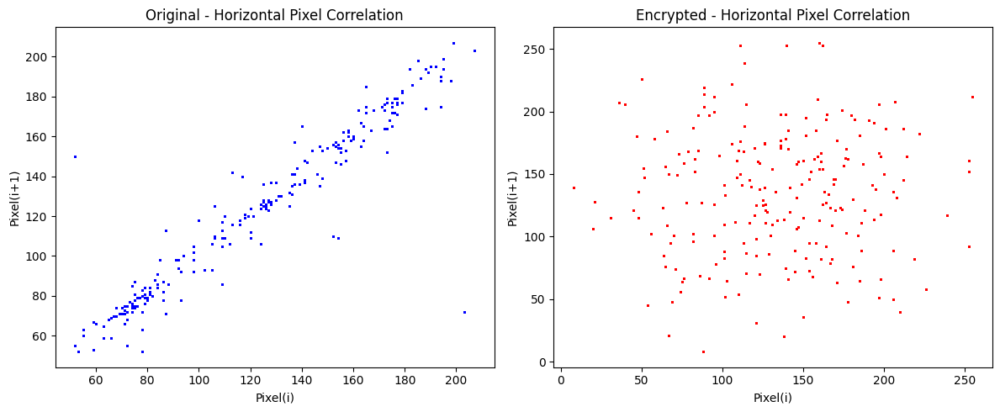

In [38]:
def plot_pixel_correlation(image1, image2, title1="Original", title2="Encrypted"):
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Sample 5000 random neighboring pixel pairs (horizontal)
    h, w = image1.shape[:2]
    x = np.random.randint(0, h)
    y = np.random.randint(0, w - 1, 5000)

    orig_vals = image1[x, y, 0].flatten()
    orig_next = image1[x, y + 1, 0].flatten()
    enc_vals = image2[x, y, 0].flatten()
    enc_next = image2[x, y + 1, 0].flatten()

    axs[0].scatter(orig_vals, orig_next, s=1, color='blue')
    axs[0].set_title(f"{title1} - Horizontal Pixel Correlation")
    axs[0].set_xlabel('Pixel(i)')
    axs[0].set_ylabel('Pixel(i+1)')

    axs[1].scatter(enc_vals, enc_next, s=1, color='red')
    axs[1].set_title(f"{title2} - Horizontal Pixel Correlation")
    axs[1].set_xlabel('Pixel(i)')
    axs[1].set_ylabel('Pixel(i+1)')

    plt.tight_layout()
    plt.show()

plot_pixel_correlation(image, encrypted_image)


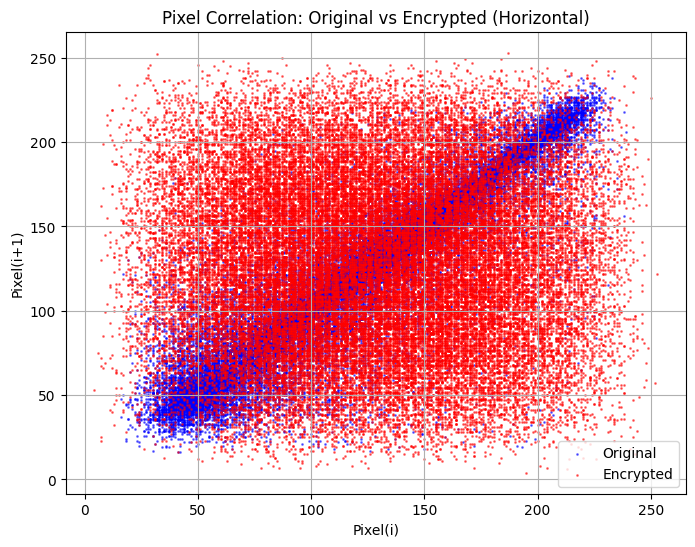

In [53]:
import numpy as np
import matplotlib.pyplot as plt

def get_adjacent_pixel_pairs(image_gray):
    # Flatten horizontal pixel pairs (Pixel(i), Pixel(i+1))
    pairs = np.column_stack((image_gray[:, :-1].ravel(), image_gray[:, 1:].ravel()))
    return pairs[:, 0], pairs[:, 1]

# Convert both images to grayscale if not already
gray_original = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
gray_encrypted = cv2.cvtColor(encrypted_image, cv2.COLOR_BGR2GRAY)

# Get pixel pairs
orig_vals, orig_next = get_adjacent_pixel_pairs(gray_original)
enc_vals, enc_next = get_adjacent_pixel_pairs(gray_encrypted)

# Plot
plt.figure(figsize=(8, 6))
plt.scatter(orig_vals, orig_next, s=1, color='blue', alpha=0.5, label="Original")
plt.scatter(enc_vals, enc_next, s=1, color='red', alpha=0.5, label="Encrypted")
plt.xlabel('Pixel(i)')
plt.ylabel('Pixel(i+1)')
plt.legend(loc='best')
plt.title("Pixel Correlation: Original vs Encrypted (Horizontal)")
plt.grid(True)
plt.show()


## 2. Difference Image Heatmap

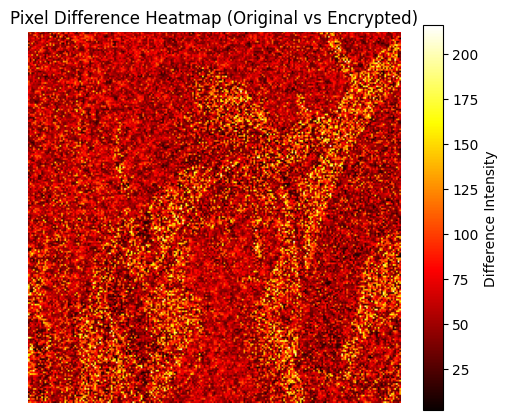

In [39]:
diff_image = cv2.absdiff(image, encrypted_image)
diff_gray = cv2.cvtColor(diff_image, cv2.COLOR_BGR2GRAY)

plt.figure(figsize=(6, 5))
plt.imshow(diff_gray, cmap='hot')
plt.title("Pixel Difference Heatmap (Original vs Encrypted)")
plt.colorbar(label='Difference Intensity')
plt.axis('off')
plt.show()


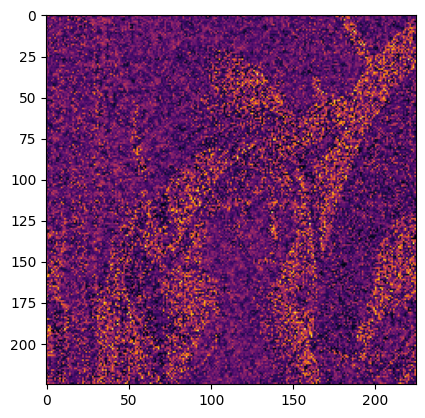

In [55]:
# Using 'inferno' colormap for better contrast
plt.imshow(diff_gray, cmap='inferno')


##  3. 3D Surface Plot of Histogram

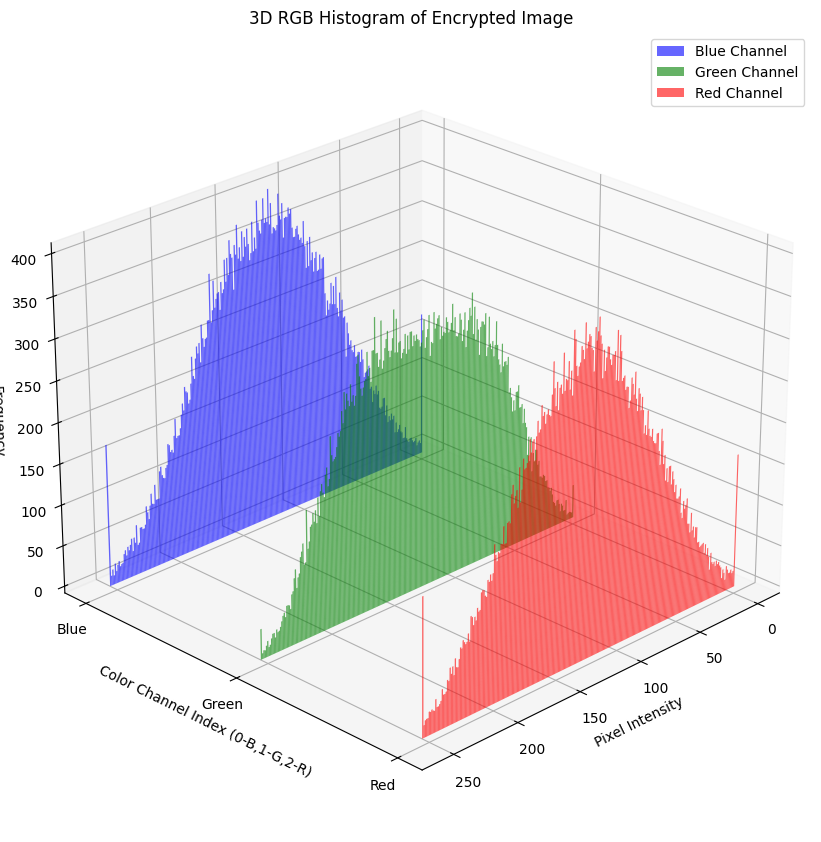

In [59]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import cv2

# Ensure encrypted_image is loaded and is a color image (BGR format)

fig = plt.figure(figsize=(14, 10))
ax = fig.add_subplot(111, projection='3d')

bins = np.arange(256)
colors = ['blue', 'green', 'red']
channel_names = ['Blue', 'Green', 'Red']

for i, (color, name) in enumerate(zip(colors, channel_names)):
    hist = cv2.calcHist([encrypted_image], [i], None, [256], [0, 256]).flatten()
    ax.bar(bins, hist, zs=i, zdir='y', color=color, alpha=0.6, label=f'{name} Channel', width=1)

ax.set_xlabel('Pixel Intensity')
ax.set_ylabel('Color Channel Index (0-B,1-G,2-R)')
ax.set_zlabel('Frequency')
ax.set_yticks([0, 1, 2])
ax.set_yticklabels(channel_names)
ax.view_init(elev=25, azim=45)
ax.set_title("3D RGB Histogram of Encrypted Image")
ax.legend(loc='upper right')

plt.subplots_adjust(left=0.1, right=0.95, top=0.9, bottom=0.1)
plt.show()


## 4. Entropy Bar Plot per Channel

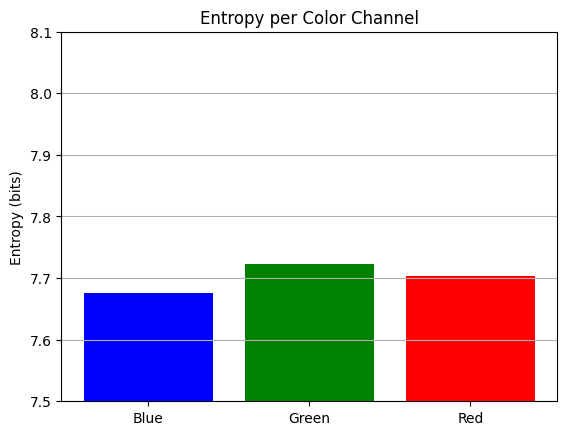

In [41]:
from scipy.stats import entropy

def calculate_entropy(channel):
    hist, _ = np.histogram(channel.flatten(), bins=256, range=(0, 256))
    prob = hist / np.sum(hist)
    return entropy(prob, base=2)

b_ent = calculate_entropy(encrypted_image[:, :, 0])
g_ent = calculate_entropy(encrypted_image[:, :, 1])
r_ent = calculate_entropy(encrypted_image[:, :, 2])

plt.bar(['Blue', 'Green', 'Red'], [b_ent, g_ent, r_ent], color=['b', 'g', 'r'])
plt.title("Entropy per Color Channel")
plt.ylabel("Entropy (bits)")
plt.ylim(7.5, 8.1)
plt.grid(axis='y')
plt.show()


## Anomaly Detection 

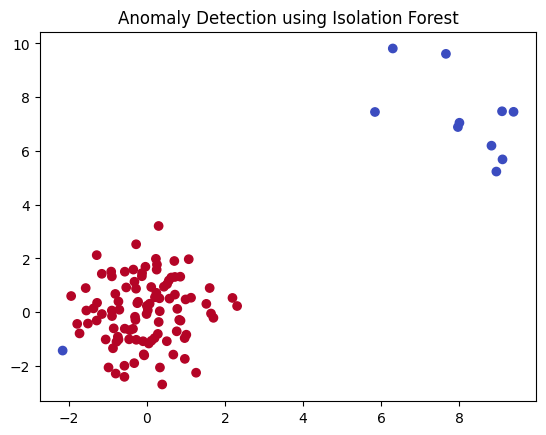

In [42]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.ensemble import IsolationForest

# Generating synthetic normal data
X_normal = np.random.normal(0, 1, (100, 2))

# Generating synthetic anomalies
X_anomaly = np.random.uniform(5, 10, (10, 2))

# Combining normal data and anomalies
X = np.vstack([X_normal, X_anomaly])

# Fitting the Isolation Forest model
model = IsolationForest(contamination=0.1)
model.fit(X)

# Predicting anomalies (-1 for anomalies, 1 for normal points)
pred = model.predict(X)

# Plotting the data
plt.scatter(X[:, 0], X[:, 1], c=pred, cmap='coolwarm')
plt.title('Anomaly Detection using Isolation Forest')
plt.show()


In [43]:
import cv2
import numpy as np
from skimage.metrics import structural_similarity as ssim

# Load images
original_image = cv2.imread("D:/crypto project/Image/Image2.jpg")
decrypted_image = cv2.imread("D:/crypto project/Image/decrypted_image.jpg")

# Convert to grayscale
gray_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2GRAY)
gray_decrypted = cv2.cvtColor(decrypted_image, cv2.COLOR_BGR2GRAY)

# MSE function
def calculate_mse(original, decrypted):
    return np.mean((original - decrypted) ** 2)

# Compute MSE and SSIM
mse_value = calculate_mse(gray_image, gray_decrypted)
ssim_value = ssim(gray_image, gray_decrypted)

print(f"Mean Squared Error (MSE): {mse_value:.4f}")
print(f"Structural Similarity Index Measure (SSIM): {ssim_value:.4f}")


Mean Squared Error (MSE): 0.2661
Structural Similarity Index Measure (SSIM): 0.9994


# Three different 3D hyperchaotic maps

In [44]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


## 1.  Lorenz 3D Map

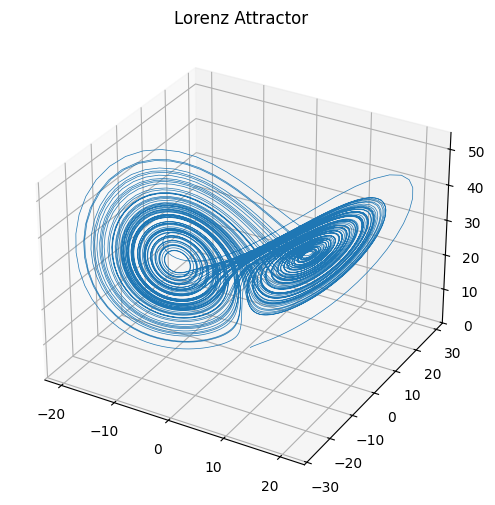

In [45]:
def lorenz_system(x, y, z, sigma=10, rho=28, beta=8/3):
    dx = sigma * (y - x)
    dy = x * (rho - z) - y
    dz = x * y - beta * z
    return dx, dy, dz

# Initial values
x, y, z = 1.0, 1.0, 1.0
dt = 0.01
steps = 10000

xs, ys, zs = [], [], []
for _ in range(steps):
    dx, dy, dz = lorenz_system(x, y, z)
    x += dx * dt
    y += dy * dt
    z += dz * dt
    xs.append(x)
    ys.append(y)
    zs.append(z)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot(xs, ys, zs, lw=0.5)
ax.set_title("Lorenz Attractor")
plt.show()


## 2.  Lü Hyperchaotic System

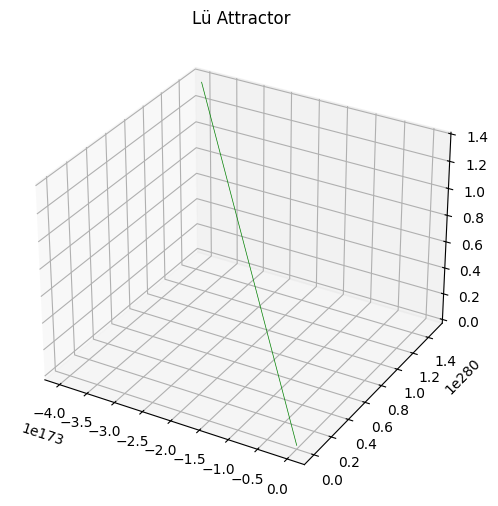

In [46]:
def lu_system(x, y, z, a=36, b=3, c=20):
    dx = a * (y - x)
    dy = -x * z + c * y
    dz = x * y - b * z
    return dx, dy, dz

x, y, z = 0.1, 0.1, 0.1
xs, ys, zs = [], [], []
for _ in range(steps):
    dx, dy, dz = lu_system(x, y, z)
    x += dx * dt
    y += dy * dt
    z += dz * dt
    xs.append(x)
    ys.append(y)
    zs.append(z)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot(xs, ys, zs, lw=0.5, color='green')
ax.set_title("Lü Attractor")
plt.show()


## 3. Chen Hyperchaotic System

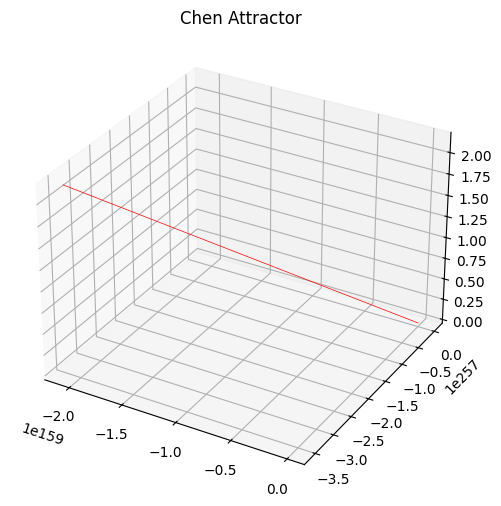

In [47]:
def chen_system(x, y, z, a=35, b=3, c=28):
    dx = a * (y - x)
    dy = (c - a) * x - x * z + c * y
    dz = x * y - b * z
    return dx, dy, dz

x, y, z = 0.2, 0.3, 0.1
xs, ys, zs = [], [], []
for _ in range(steps):
    dx, dy, dz = chen_system(x, y, z)
    x += dx * dt
    y += dy * dt
    z += dz * dt
    xs.append(x)
    ys.append(y)
    zs.append(z)

fig = plt.figure(figsize=(8, 6))
ax = fig.add_subplot(111, projection='3d')
ax.plot(xs, ys, zs, lw=0.5, color='red')
ax.set_title("Chen Attractor")
plt.show()


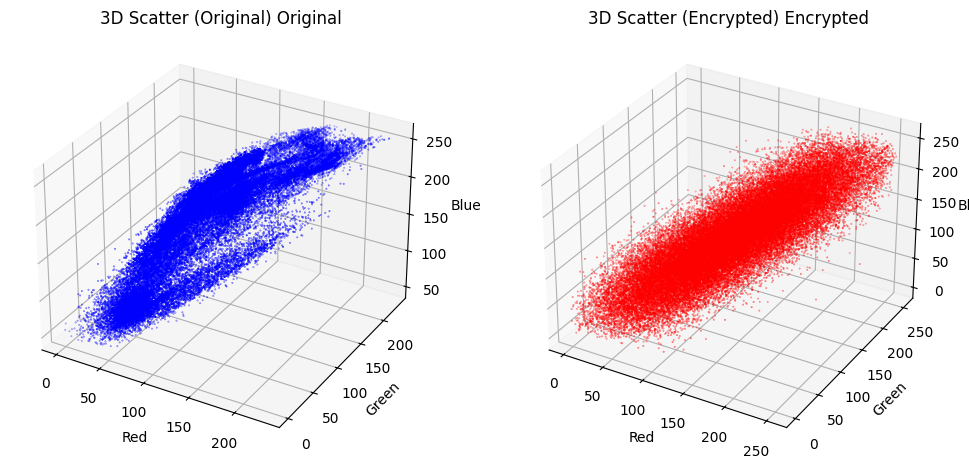

In [68]:
from mpl_toolkits.mplot3d import Axes3D

def plot_3d_scatter(image1, image2, title1, title2):
    fig = plt.figure(figsize=(12, 6))

    # 3D scatter plot for Original Image
    ax1 = fig.add_subplot(121, projection='3d')
    r1, g1, b1 = cv2.split(image1)
    ax1.scatter(r1.flatten(), g1.flatten(), b1.flatten(), color='blue', s=0.1)
    ax1.set_title(f"3D Scatter (Original) {title1}")
    ax1.set_xlabel('Red')
    ax1.set_ylabel('Green')
    ax1.set_zlabel('Blue')

    # 3D scatter plot for Encrypted Image
    ax2 = fig.add_subplot(122, projection='3d')
    r2, g2, b2 = cv2.split(image2)
    ax2.scatter(r2.flatten(), g2.flatten(), b2.flatten(), color='red', s=0.1)
    ax2.set_title(f"3D Scatter (Encrypted) {title2}")
    ax2.set_xlabel('Red')
    ax2.set_ylabel('Green')
    ax2.set_zlabel('Blue')

    plt.show()

# Plot 3D RGB Scatter for Original and Encrypted
plot_3d_scatter(original_image, encrypted_image, "Original", "Encrypted")


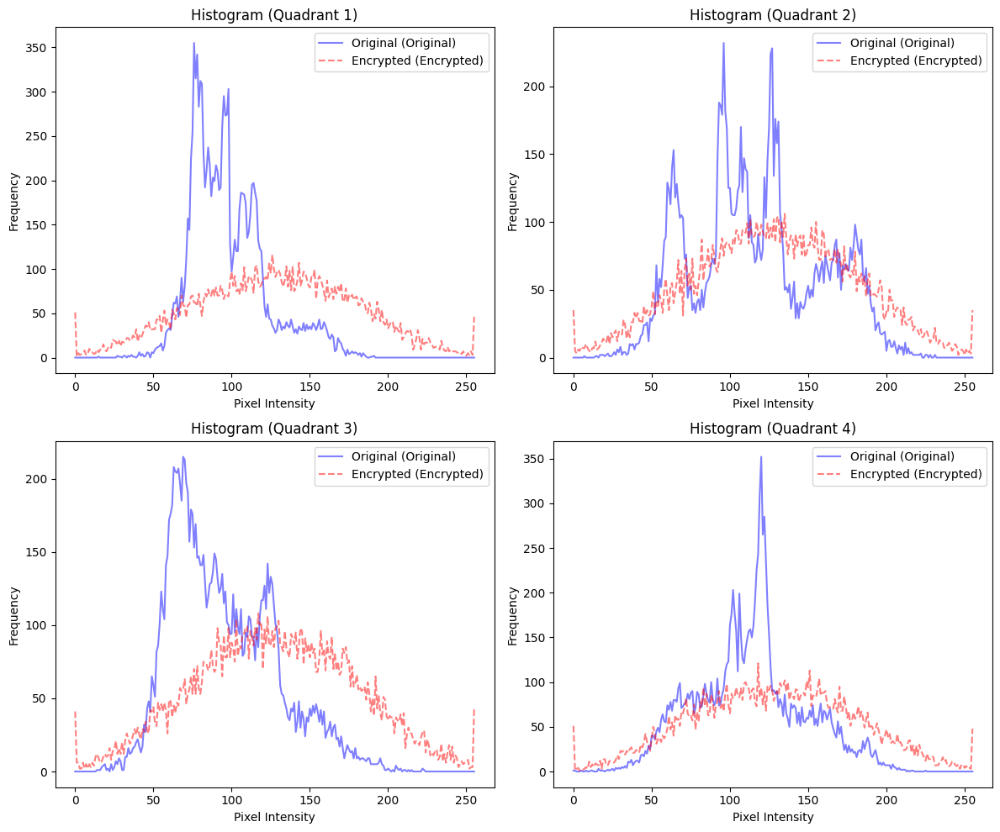

In [70]:
def plot_region_based_distribution(image1, image2, title1, title2):
    height, width = image1.shape[:2]
    quadrants = [
        (0, width//2, 0, height//2),  # Top-left
        (width//2, width, 0, height//2),  # Top-right
        (0, width//2, height//2, height),  # Bottom-left
        (width//2, width, height//2, height)  # Bottom-right
    ]
    
    fig, axes = plt.subplots(2, 2, figsize=(12, 10))

    for i, (x1, x2, y1, y2) in enumerate(quadrants):
        # Extract quadrant
        quad1 = image1[y1:y2, x1:x2]
        quad2 = image2[y1:y2, x1:x2]

        # Calculate histograms
        hist1 = cv2.calcHist([quad1], [0], None, [256], [0, 256]).flatten()
        hist2 = cv2.calcHist([quad2], [0], None, [256], [0, 256]).flatten()

        ax = axes[i//2, i%2]
        ax.plot(hist1, color='blue', label=f'{title1} (Original)', alpha=0.5)
        ax.plot(hist2, color='red', label=f'{title2} (Encrypted)', linestyle='--', alpha=0.5)
        ax.set_title(f"Histogram (Quadrant {i+1})")
        ax.set_xlabel('Pixel Intensity')
        ax.set_ylabel('Frequency')
        ax.legend()

    plt.tight_layout()
    plt.show()

# Example: Quadrant-based Distribution for Original vs Encrypted
plot_region_based_distribution(original_image, encrypted_image, "Original", "Encrypted")


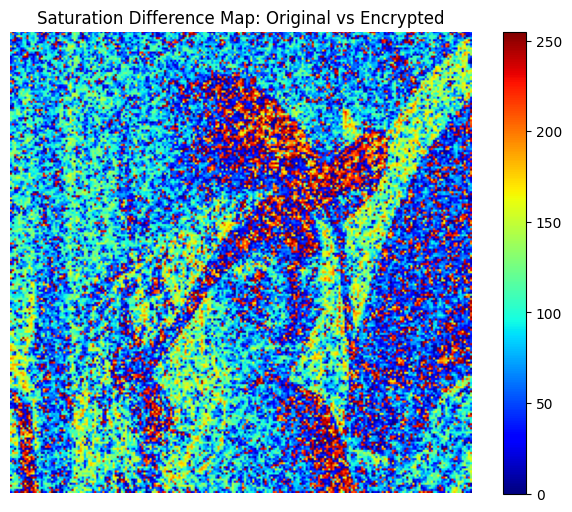

In [71]:
def plot_saturation_map(image1, image2, title1, title2):
    # Convert both images to HSV for saturation
    hsv1 = cv2.cvtColor(image1, cv2.COLOR_BGR2HSV)
    hsv2 = cv2.cvtColor(image2, cv2.COLOR_BGR2HSV)

    # Extract saturation channel
    sat1 = hsv1[:, :, 1]
    sat2 = hsv2[:, :, 1]

    # Plot Saturation Map Difference
    plt.figure(figsize=(8, 6))
    diff_saturation = np.abs(sat1 - sat2)
    plt.imshow(diff_saturation, cmap='jet')
    plt.colorbar()
    plt.title(f"Saturation Difference Map: {title1} vs {title2}")
    plt.axis('off')
    plt.show()

# Example: Saturation Map for Original vs Encrypted
plot_saturation_map(original_image, encrypted_image, "Original", "Encrypted")


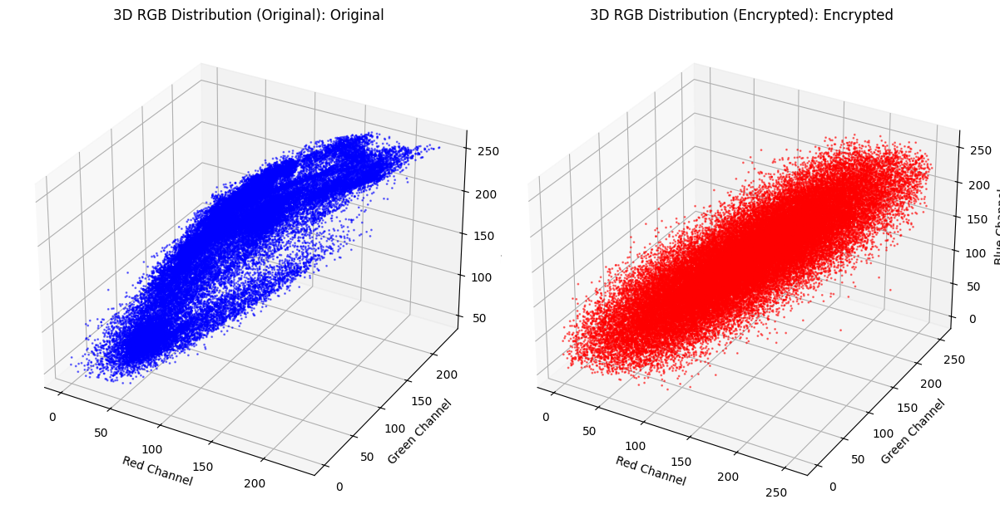

In [72]:
from mpl_toolkits.mplot3d import Axes3D

def plot_3d_color_distribution(image1, image2, title1, title2):
    fig = plt.figure(figsize=(12, 7))

    # 3D scatter for Original Image
    ax1 = fig.add_subplot(121, projection='3d')
    r1, g1, b1 = cv2.split(image1)
    ax1.scatter(r1.flatten(), g1.flatten(), b1.flatten(), color='blue', s=1, alpha=0.5)
    ax1.set_title(f"3D RGB Distribution (Original): {title1}")
    ax1.set_xlabel('Red Channel')
    ax1.set_ylabel('Green Channel')
    ax1.set_zlabel('Blue Channel')

    # 3D scatter for Encrypted Image
    ax2 = fig.add_subplot(122, projection='3d')
    r2, g2, b2 = cv2.split(image2)
    ax2.scatter(r2.flatten(), g2.flatten(), b2.flatten(), color='red', s=1, alpha=0.5)
    ax2.set_title(f"3D RGB Distribution (Encrypted): {title2}")
    ax2.set_xlabel('Red Channel')
    ax2.set_ylabel('Green Channel')
    ax2.set_zlabel('Blue Channel')

    plt.tight_layout()
    plt.show()

# Example: 3D Color Distribution for Original vs Encrypted
plot_3d_color_distribution(original_image, encrypted_image, "Original", "Encrypted")


Image 1 shape: (225, 225, 3), dtype: uint8
Image 2 shape: (225, 225, 3), dtype: uint8
